In this notebook, I will create a function that gives a LIME explanation of every time series regression model.
If we don't have LIME install, we should import it:

In [1]:
%pip install lime
%pip install tslearn
%pip install openpyxl


[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.

[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.

[notice] A new release of pip is available: 23.0.1 -> 23.1.2
[notice] To update, run: pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [1]:
from lime.lime_tabular import RecurrentTabularExplainer
from tslearn.metrics import dtw
import matplotlib.pyplot as plt
import re
import heapq

def explain_model(X_train, model, x_test, features_names=None):
    explainer = RecurrentTabularExplainer(X_train, mode='regression', feature_names=features_names)
    explained = explainer.explain_instance(x_test, classifier_fn=model.predict, num_samples=90000, num_features=20)
    
    bias_term = explained.intercept[0]
    print(f"Bias LIME term: {bias_term}")
    explained.as_pyplot_figure()
    list(map(lambda x: print(x), explained.as_list()))
    explained.show_in_notebook()

    print("Based on the LIME explanation, the following features had the most influence on the model's prediction:")
    features = explained.as_list()
    features_without_time = {}

    for feature in features:
        # Regex nightmare
        match1 = re.search(r'^(.*?)_t-', feature[0])
        match2 = re.search(r'<\s*(.*?)_t-', feature[0])

        if match1:
            feature_name = match1.group(1)
        if match2:
            feature_name = match2.group(1)

        value = feature[1]

        if feature_name in features_without_time:
            features_without_time[feature_name] += abs(value)
        else:
            features_without_time[feature_name] = abs(value)

    for idx, (name, value) in enumerate(features_without_time.items()):
        if idx < len(features_without_time) - 1:
            print(f"{name}, with a weight of {round(value, 6)}", end=',\n')
        else:
            print(f"{name}, with a weight of {round(value, 6)}", end='.\n')
            
        

    # "Based on the LIME explanation, the following features had the most influence on the model’s prediction:
    # [list of the features with their corresponding weights].
    # The model gave more importance to [feature_x] at time step [t] with a weight of [weight_x_t].
    # For this specific instance, it looks like the model relies heavily on [important feature names] to make its prediction.”

    top_feature = explained.as_list()[0] 
    name = top_feature[0]
    match1 = re.search(r'^(.*?)_t-', name)
    match2 = re.search(r'<\s*(.*?)_t-', name)

    if match1:
        name = match1.group(1)
    if match2:
        name = match2.group(1)

    # Another regex nightmare to get the t-x part of the string
    time_step = top_feature[0]
    match1 = re.match(r'(.+)_t-(\d+) [\S\s]*', time_step)
    if match1:
        time_step = match1.group(2)
    match2 = re.match(r'[^<]+<\s*(\S+)_t-(\d+) [\S\s]*', time_step)
    if match2:
        time_step = match2.group(2)
    
    value = top_feature[1]
    print(f"The model gave the most importance to the feature {name} at time step t-{time_step}, with a weight of {round(value, 6)}")

    print("For this specific instance, it looks like the model relies heavily on", end=' ')

    n = 4
    sorted_features = sorted(features_without_time.items(), key=lambda x: abs(x[1]), reverse=True)
    
    top_n = sorted_features[:n]
    for i, item in enumerate(top_n):
        if i < len(top_n) - 1:
            print(item[0], end=', ')
        else:
            print(item[0], end='.\n')

    return explained
    

I want to also include XCM for Regression. We have to import the file xcm_starter:

In [2]:
from xcm_starter import xcm_start

Let's try to use a few datasets/models to check the result.
First, this Air Quality dataset:

In [2]:
import pandas as pd

df = pd.read_csv("AirQualityUCI.csv", sep=';')


In [5]:
df.tail(6)

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
9465,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9466,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9467,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9468,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9469,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9470,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<AxesSubplot: >

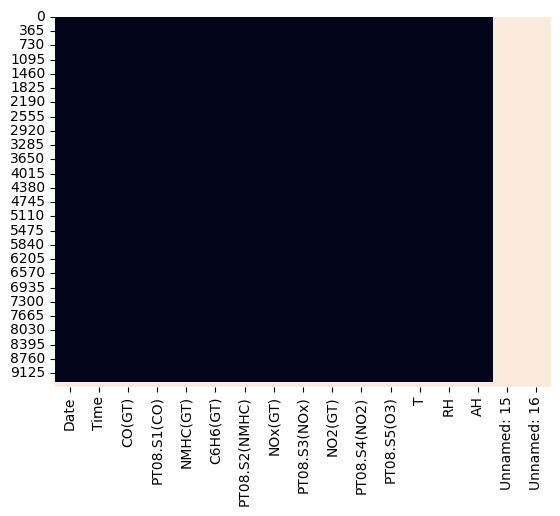

In [3]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(df.isna(), cbar=False)

Let's drop NaN rows and columns.

In [4]:
df = df.drop(['Unnamed: 15', 'Unnamed: 16'], axis=1)
df = df.dropna()

In [8]:
df.tail(6)

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
9351,04/04/2005,09.00.00,"3,9",1297.0,-200.0,"13,6",1102.0,523.0,507.0,187.0,1375.0,1583.0,"18,2","36,3","0,7487"
9352,04/04/2005,10.00.00,"3,1",1314.0,-200.0,"13,5",1101.0,472.0,539.0,190.0,1374.0,1729.0,"21,9","29,3","0,7568"
9353,04/04/2005,11.00.00,"2,4",1163.0,-200.0,"11,4",1027.0,353.0,604.0,179.0,1264.0,1269.0,"24,3","23,7","0,7119"
9354,04/04/2005,12.00.00,"2,4",1142.0,-200.0,"12,4",1063.0,293.0,603.0,175.0,1241.0,1092.0,"26,9","18,3","0,6406"
9355,04/04/2005,13.00.00,"2,1",1003.0,-200.0,"9,5",961.0,235.0,702.0,156.0,1041.0,770.0,"28,3","13,5","0,5139"
9356,04/04/2005,14.00.00,"2,2",1071.0,-200.0,"11,9",1047.0,265.0,654.0,168.0,1129.0,816.0,"28,5","13,1","0,5028"


There are some columns that represent the decimal with commas, and some that represent it with point. Let's uniform that. 

In [5]:
df['CO(GT)'] = df['CO(GT)'].str.replace(',', '.').astype(float)
df['C6H6(GT)'] = df['C6H6(GT)'].str.replace(',', '.').astype(float)
df['T'] = df['T'].str.replace(',', '.').astype(float)
df['RH'] = df['RH'].str.replace(',', '.').astype(float)
df['AH'] = df['AH'].str.replace(',', '.').astype(float)


Let's say we want to predict temperature, so we rename that column as Y:

In [6]:
df = df.rename(columns={'T':'Y'})

In [11]:
df.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),Y,RH,AH
0,10/03/2004,18.00.00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004,19.00.00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004,20.00.00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502
3,10/03/2004,21.00.00,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867
4,10/03/2004,22.00.00,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888


I want to use a unique column for DateTime.

In [7]:
df['DateTime'] = pd.to_datetime(df['Date'] + ' ' + df['Time'], format='%d/%m/%Y %H.%M.%S')

df = df.drop(['Date', 'Time'], axis=1)

In [13]:
df.head()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),Y,RH,AH,DateTime
0,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,2004-03-10 18:00:00
1,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,2004-03-10 19:00:00
2,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,2004-03-10 20:00:00
3,2.2,1376.0,80.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,2004-03-10 21:00:00
4,1.6,1272.0,51.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,2004-03-10 22:00:00


Our index should be DateTime.

In [8]:
df.set_index('DateTime', inplace=True)

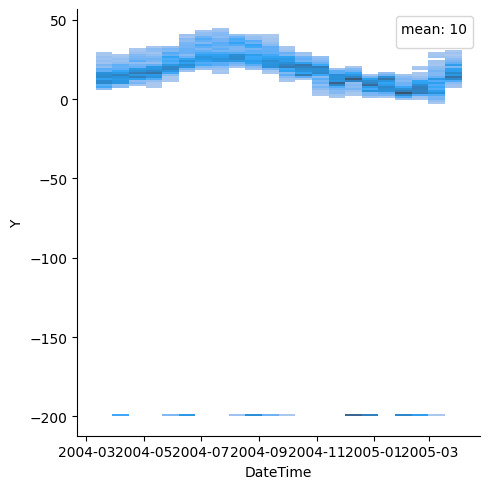

In [15]:
sns.displot(data=df, x='DateTime', y='Y')
plt.legend(title='mean: {:,.0f}'.format(df["Y"].mean()), labels=[])
plt.show()

There are some values that are set to -200 that represent a NaN. I want to substitute them with an interpolation.

In [4]:
import numpy as np
df.replace(-200, np.nan, inplace=True)
df.interpolate(method='linear', axis=0, inplace=True)

Now we generate samples of 7 days.

In [5]:
from sklearn.model_selection import train_test_split

# Shift the 'Y' column by 1 to get the past values of 'Y' and create a new column named 'past_Y'
df['past_Y'] = df['Y'].shift(1)

features = df.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1


# Fill the NaN value at the first row with a suitable initial value (e.g., mean)
initial_value = df['Y'].mean()
df['past_Y'].fillna(initial_value, inplace=True)


# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df) - window_size+1, stride):
    # extract the input features including the 'past_Y' values for this window
    X = df.iloc[i:i+window_size, df.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)

KeyError: 'Y'

Let's create the model now:

In [6]:
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense

n_samples = X_train.shape[0]
n_timesteps = X_train.shape[1]
n_features = X_train.shape[2]
model = Sequential()
model.add(Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(n_timesteps, n_features)))
model.add(Flatten())
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

model.compile(optimizer='adam', loss='mse')

NameError: name 'X_train' is not defined

In [19]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv1d (Conv1D)             (None, 5, 64)             2560      
                                                                 
 flatten (Flatten)           (None, 320)               0         
                                                                 
 dense (Dense)               (None, 4)                 1284      
                                                                 
 dense_1 (Dense)             (None, 1)                 5         
                                                                 
Total params: 3,849
Trainable params: 3,849
Non-trainable params: 0
_________________________________________________________________


And now we fit the model:

In [20]:
model.fit(X_train, y_train, epochs=100, batch_size=128, validation_data=(X_test, y_test), verbose=1)

Epoch 1/100


2023-05-15 20:05:19.561757: W tensorflow/core/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


59/59 [==============================] - 0s 2ms/step - loss: 478.5849 - val_loss: 133.7462
Epoch 2/100
59/59 [==============================] - 0s 997us/step - loss: 474.9316 - val_loss: 132.5795
Epoch 3/100
59/59 [==============================] - 0s 1ms/step - loss: 472.5576 - val_loss: 131.4206
Epoch 4/100
59/59 [==============================] - 0s 1ms/step - loss: 470.1945 - val_loss: 130.2716
Epoch 5/100
59/59 [==============================] - 0s 1ms/step - loss: 467.8387 - val_loss: 129.1314
Epoch 6/100
59/59 [==============================] - 0s 1ms/step - loss: 465.4956 - val_loss: 127.9972
Epoch 7/100
59/59 [==============================] - 0s 1ms/step - loss: 463.1625 - val_loss: 126.8729
Epoch 8/100
59/59 [==============================] - 0s 1ms/step - loss: 460.8376 - val_loss: 125.7599
Epoch 9/100
59/59 [==============================] - 0s 1ms/step - loss: 458.5272 - val_loss: 124.6488
Epoch 10/100
59/59 [==============================] - 0s 1ms/step - loss: 456.2209 

In [21]:
y_pred = model.predict(X_test)
print(y_pred)

59/59 [==============================] - 0s 375us/step
[[5.6613297]
 [5.6613297]
 [5.6613297]
 ...
 [5.6613297]
 [5.6613297]
 [5.6613297]]


In [22]:
print(y_pred[12])
print(y_test[12])

[5.6613297]
[3.7]


In [23]:
print(y_pred[13])
print(y_test[13])

[5.6613297]
[2.6]


In [24]:
from sklearn.metrics import mean_absolute_error
print(mean_absolute_error(y_pred, y_test))

5.479793477988638


Time for explanation! Let's pass to this function a model and see what it can do:

2813/2813 [==============================] - 1s 414us/step
Bias LIME term: 5.660872185143055
('NMHC(GT)_t-6 <= 275.00', 0.0028020026782031105)
('PT08.S3(NOx)_t-1 > 979.00', -0.0007674824292884006)
('PT08.S3(NOx)_t-3 > 979.00', -0.0007614865633056366)
('PT08.S1(CO)_t-4 <= 937.00', -0.0007327270382452449)
('744.00 < PT08.S5(O3)_t-2 <= 969.00', -0.0007266698014884282)
('35.40 < RH_t-6 <= 49.90', -0.000725476797823099)
('AH_t-5 <= 0.87', -0.0006045233429076681)
('PT08.S2(NMHC)_t-4 <= 763.00', -0.0006036665427836727)
('PT08.S1(CO)_t-3 <= 937.00', -0.000595555410376866)
('PT08.S2(NMHC)_t-1 <= 763.00', -0.0005947755464855828)
('AH_t-2 <= 0.87', -0.0005946457965906928)
('744.00 < PT08.S5(O3)_t-5 <= 969.00', -0.0005895536700127653)
('past_Y_t-3 <= 14.10', -0.0005868658668482157)
('PT08.S3(NOx)_t-6 > 979.00', -0.0005866808442909532)
('5.00 < C6H6(GT)_t-5 <= 8.80', -0.0005851089920692656)
('87.00 < NOx(GT)_t-3 <= 164.00', -0.0005784278284025018)
('49.85 < RH_t-1 <= 62.30', -0.0005765109742653673)

Based on the LIME explanation, the following features had the most influence on the model's prediction:
NMHC(GT), with a weight of 0.002802,
PT08.S3(NOx), with a weight of 0.002116,
PT08.S1(CO), with a weight of 0.001328,
PT08.S5(O3), with a weight of 0.001316,
RH, with a weight of 0.001302,
AH, with a weight of 0.001199,
PT08.S2(NMHC), with a weight of 0.001198,
past_Y, with a weight of 0.000587,
C6H6(GT), with a weight of 0.000585,
NOx(GT), with a weight of 0.000578,
NO2(GT), with a weight of 0.000538,
CO(GT), with a weight of 0.000263.
The model gave the most importance to the feature NMHC(GT) at time step t-6, with a weight of 0.002802
For this specific instance, it looks like the model relies heavily on NMHC(GT), PT08.S3(NOx), PT08.S1(CO), PT08.S5(O3).


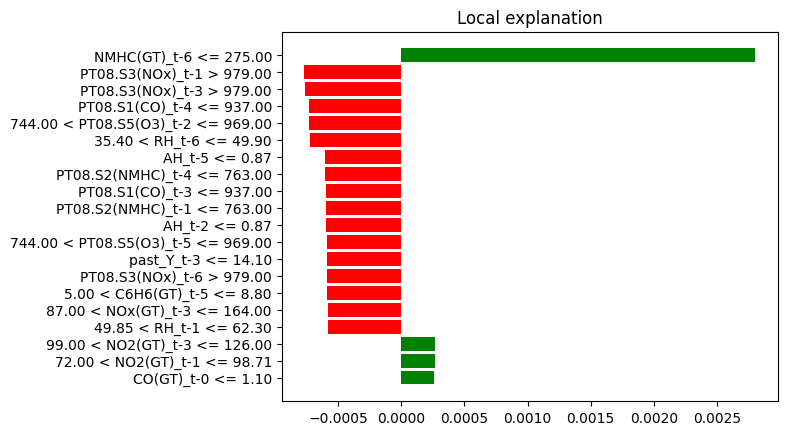

In [25]:
explain_model(X_train, model, X_test[12], features_names=input_features)

2813/2813 [==============================] - 1s 410us/step
Bias LIME term: 5.661375149298206
('NMHC(GT)_t-5 <= 275.00', 0.0008632784254252753)
('NO2(GT)_t-5 > 126.00', -0.00019845048553953897)
('PT08.S5(O3)_t-2 <= 744.00', -0.0001948355300606255)
('AH_t-3 <= 0.87', -0.00019457154643018665)
('PT08.S2(NMHC)_t-5 <= 763.00', -0.00019358529097094284)
('PT08.S3(NOx)_t-0 > 979.00', -0.0001920892076578713)
('AH_t-4 <= 0.87', -0.00019157564229621365)
('past_Y_t-3 <= 14.10', -0.00019007568955700183)
('C6H6(GT)_t-5 <= 5.00', -0.00019004644766507228)
('937.00 < PT08.S1(CO)_t-6 <= 1070.00', -0.00018992382519819265)
('past_Y_t-4 <= 14.10', -0.00018911153517331295)
('PT08.S3(NOx)_t-3 > 979.00', -0.00018899780412492286)
('49.80 < RH_t-0 <= 62.30', -0.00018775468873708336)
('87.00 < NOx(GT)_t-4 <= 164.00', -0.00018723311975277714)
('99.00 < NO2(GT)_t-4 <= 126.00', -0.00018655890517701312)
('PT08.S1(CO)_t-1 <= 937.00', -0.0001863868659986543)
('C6H6(GT)_t-3 <= 5.00', -0.0001860811543566179)
('PT08.S2(NM

Based on the LIME explanation, the following features had the most influence on the model's prediction:
NMHC(GT), with a weight of 0.000863,
NO2(GT), with a weight of 0.000385,
PT08.S5(O3), with a weight of 0.000195,
AH, with a weight of 0.000386,
PT08.S2(NMHC), with a weight of 0.000563,
PT08.S3(NOx), with a weight of 0.000381,
past_Y, with a weight of 0.000379,
C6H6(GT), with a weight of 0.000376,
PT08.S1(CO), with a weight of 0.000376,
RH, with a weight of 0.000188,
NOx(GT), with a weight of 0.000187,
PT08.S4(NO2), with a weight of 0.000183.
The model gave the most importance to the feature NMHC(GT) at time step t-5, with a weight of 0.000863
For this specific instance, it looks like the model relies heavily on NMHC(GT), PT08.S2(NMHC), AH, NO2(GT).


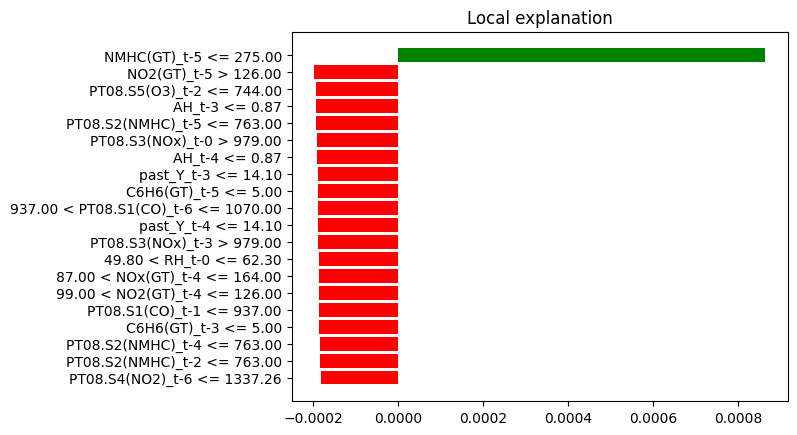

In [26]:
explain_model(X_train, model, X_test[13], features_names=input_features)

As we can see, there is little difference between nearby samples.

Let's try with a different model: LSTM

In [27]:
from keras.models import Sequential
from keras.layers import LSTM, Dense

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(64, input_shape=input_shape))
model.add(Dense(1))


model.compile(optimizer='adam', loss='mse')

In [28]:
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))

Epoch 1/100
234/234 [==============================] - 2s 3ms/step - loss: 311.3387 - val_loss: 37.7615
Epoch 2/100
234/234 [==============================] - 0s 2ms/step - loss: 161.8890 - val_loss: 41.8776
Epoch 3/100
234/234 [==============================] - 1s 2ms/step - loss: 98.7943 - val_loss: 60.9387
Epoch 4/100
234/234 [==============================] - 0s 2ms/step - loss: 72.4717 - val_loss: 78.0772
Epoch 5/100
234/234 [==============================] - 0s 2ms/step - loss: 60.6862 - val_loss: 78.6969
Epoch 6/100
234/234 [==============================] - 0s 2ms/step - loss: 52.6826 - val_loss: 91.6090
Epoch 7/100
234/234 [==============================] - 1s 2ms/step - loss: 47.4264 - val_loss: 75.9013
Epoch 8/100
234/234 [==============================] - 0s 2ms/step - loss: 42.3992 - val_loss: 70.1566
Epoch 9/100
234/234 [==============================] - 0s 2ms/step - loss: 38.6214 - val_loss: 62.1296
Epoch 10/100
234/234 [==============================] - 0s 2ms/step - l

In [29]:
y_pred = model.predict(X_test)
print(mean_absolute_error(y_pred, y_test))

59/59 [==============================] - 0s 778us/step
1.9198994396586269


In [30]:
print(y_pred[19])
print(y_test[19])

[6.245244]
[8.2]


In [31]:
print(y_pred[20])
print(y_test[20])

[8.320405]
[10.5]


2813/2813 [==============================] - 2s 782us/step
Bias LIME term: 21.125506636176556
('past_Y_t-0 <= 14.10', -5.03094389829281)
('PT08.S2(NMHC)_t-0 > 1138.00', -4.472515270019712)
('PT08.S4(NO2)_t-0 <= 1336.75', -2.1428216863052776)
('NOx(GT)_t-0 > 308.00', 1.6682375133464868)
('NMHC(GT)_t-0 <= 275.00', 1.4011990265838825)
('PT08.S3(NOx)_t-0 <= 669.00', 1.2958645092108658)
('35.30 < RH_t-0 <= 49.80', 0.7536410996184402)
('NO2(GT)_t-0 > 126.00', -0.6424307644695055)
('PT08.S5(O3)_t-0 > 1285.25', 0.6382338814805012)
('CO(GT)_t-0 > 3.00', -0.4443888443484717)
('C6H6(GT)_t-0 > 14.70', -0.36349392549265974)
('AH_t-0 <= 0.87', -0.3152385078684551)
('PT08.S4(NO2)_t-5 <= 1337.00', -0.27600076654066874)
('PT08.S1(CO)_t-3 > 1243.00', -0.25055343621871534)
('PT08.S4(NO2)_t-1 <= 1337.00', -0.24700223568516355)
('PT08.S4(NO2)_t-4 <= 1337.00', -0.2246051075184078)
('PT08.S4(NO2)_t-6 <= 1337.26', -0.21508367505564854)
('PT08.S3(NOx)_t-4 > 979.00', -0.21414509570781215)
('past_Y_t-3 <= 14.10'

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 5.219057,
PT08.S2(NMHC), with a weight of 4.472515,
PT08.S4(NO2), with a weight of 3.28554,
NOx(GT), with a weight of 1.668238,
NMHC(GT), with a weight of 1.401199,
PT08.S3(NOx), with a weight of 1.51001,
RH, with a weight of 0.753641,
NO2(GT), with a weight of 0.642431,
PT08.S5(O3), with a weight of 0.638234,
CO(GT), with a weight of 0.444389,
C6H6(GT), with a weight of 0.363494,
AH, with a weight of 0.315239,
PT08.S1(CO), with a weight of 0.250553.
The model gave the most importance to the feature past_Y at time step t-0, with a weight of -5.030944
For this specific instance, it looks like the model relies heavily on past_Y, PT08.S2(NMHC), PT08.S4(NO2), NOx(GT).


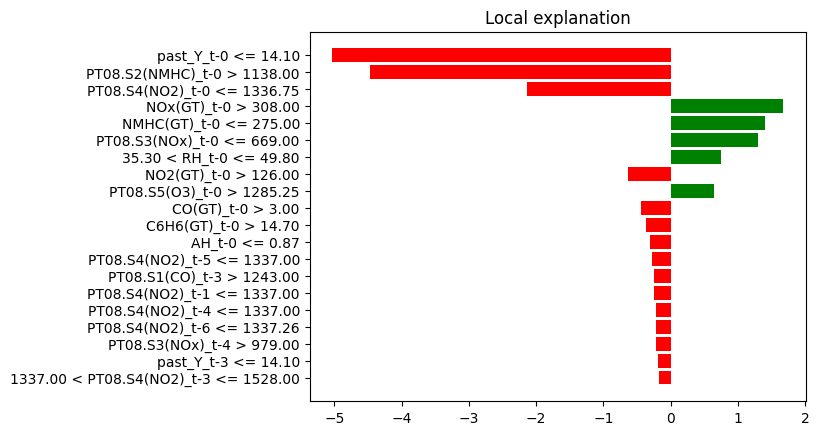

In [32]:
explain_model(X_train, model, X_test[19], input_features)

2813/2813 [==============================] - 2s 771us/step
Bias LIME term: 18.75557669880314
('RH_t-0 <= 35.30', 5.608410204924123)
('past_Y_t-0 <= 14.10', -5.036007994976166)
('PT08.S4(NO2)_t-0 <= 1336.75', -2.1666495854915646)
('NOx(GT)_t-0 > 308.00', 1.665067395225019)
('PT08.S3(NOx)_t-0 <= 669.00', 1.3451555124975967)
('NMHC(GT)_t-0 <= 275.00', 1.3189484723762293)
('933.00 < PT08.S2(NMHC)_t-0 <= 1138.00', -0.8471323360239542)
('PT08.S5(O3)_t-0 > 1285.25', 0.6880663112406498)
('NO2(GT)_t-0 > 126.00', -0.6235327044490451)
('PT08.S4(NO2)_t-2 <= 1337.00', -0.25876205824718496)
('AH_t-0 <= 0.87', -0.22784574983097453)
('PT08.S4(NO2)_t-5 <= 1337.00', -0.22703249444911536)
('PT08.S3(NOx)_t-6 > 979.00', -0.21241512844270857)
('PT08.S3(NOx)_t-5 > 979.00', -0.20090349927374232)
('PT08.S4(NO2)_t-6 <= 1337.26', -0.19492260420847085)
('PT08.S4(NO2)_t-1 <= 1337.00', -0.19118621783198209)
('PT08.S2(NMHC)_t-5 <= 763.00', 0.17660617780039198)
('past_Y_t-3 <= 14.10', -0.14226801905843034)
('PT08.S2(

Based on the LIME explanation, the following features had the most influence on the model's prediction:
RH, with a weight of 5.60841,
past_Y, with a weight of 5.178276,
PT08.S4(NO2), with a weight of 3.038553,
NOx(GT), with a weight of 1.665067,
PT08.S3(NOx), with a weight of 1.758474,
NMHC(GT), with a weight of 1.318948,
PT08.S2(NMHC), with a weight of 1.164846,
PT08.S5(O3), with a weight of 0.688066,
NO2(GT), with a weight of 0.623533,
AH, with a weight of 0.227846,
PT08.S1(CO), with a weight of 0.14082.
The model gave the most importance to the feature RH at time step t-0, with a weight of 5.60841
For this specific instance, it looks like the model relies heavily on RH, past_Y, PT08.S4(NO2), PT08.S3(NOx).


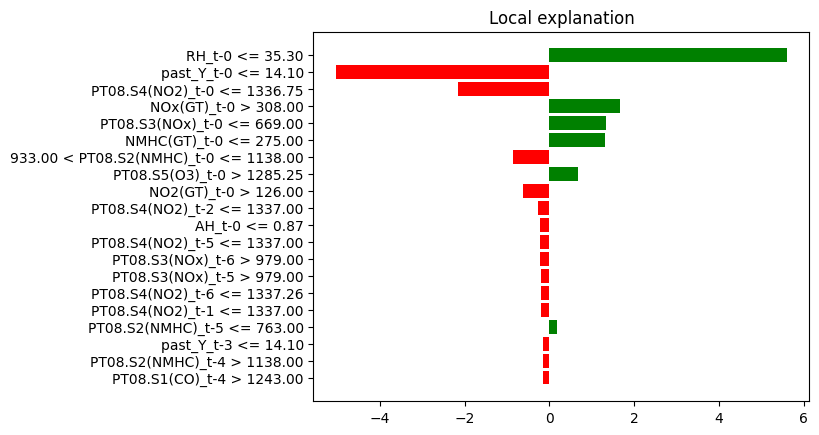

In [33]:
explain_model(X_train, model, X_test[20], features_names=input_features)

Here, the distance between the samples is a bit far. For example:
past_Y_t-0 is close, so their weight is close too (-5.84918385636236 vs -5.838723713979627).
PT08.S2(NMHC)_t-0 is in another threshold, so its weight changes significantly (-3.510987965817944 vs -0.6373512579384727).
PT08.S2(NO2)_t-0: again, same threshold, very close value (-3.428133942095211 vs -3.419279158135313).

And so on.

Let's try to use the XCM Model with explainability-by-design component on this dataset:


Dataset loaded
Training set size: 7480
Testing set size: 1871
X_train.shape:  (7480, 7, 12, 1)
X_test.shape:  (1871, 7, 12, 1)

Training on fold 1
XCM Model Loaded
Epoch 1/100
79/79 [==============================] - 2s 6ms/step - loss: 156.8511 - mean_absolute_error: 11.6544 - val_loss: 156.5047 - val_mean_absolute_error: 11.2471
Epoch 2/100
79/79 [==============================] - 0s 4ms/step - loss: 55.4282 - mean_absolute_error: 6.2771 - val_loss: 197.8704 - val_mean_absolute_error: 13.1794
Epoch 3/100
79/79 [==============================] - 0s 4ms/step - loss: 14.0054 - mean_absolute_error: 2.9527 - val_loss: 172.4529 - val_mean_absolute_error: 12.3831
Epoch 4/100
79/79 [==============================] - 0s 4ms/step - loss: 6.0838 - mean_absolute_error: 1.9380 - val_loss: 65.9986 - val_mean_absolute_error: 7.2414
Epoch 5/100
79/79 [==============================] - 0s 4ms/step - loss: 5.3756 - mean_absolute_error: 1.8267 - val_loss: 116.2104 - val_mean_absolute_error: 10.1273
Ep

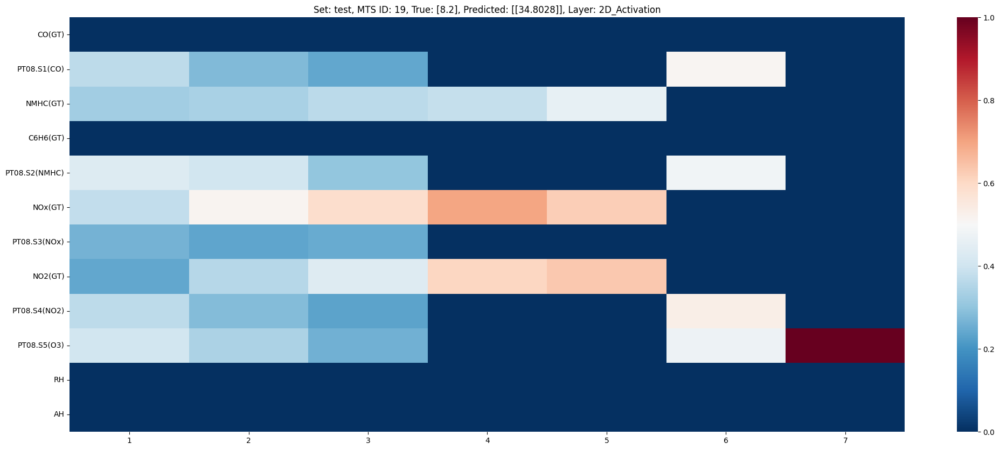

In [12]:
model = xcm_start(X_train, y_train, X_test, y_test, input_features)

Let's try to use the model of Istanbul Stock Exchange:

In [ ]:
df = pd.read_excel("data_akbilgic.xlsx")

In [ ]:
df.tail(14)

,date,TL BASED ISE,USD BASED ISE,SP,DAX,FTSE,NIKKEI,BOVESPA,EU,EM
522,2011-02-03,-0.024478,-0.027850,0.002351,0.001392,-0.002804,-0.002489,0.001154,-0.002883,0.000476
523,2011-02-04,0.024507,0.013959,0.002880,0.003127,0.002354,0.010695,-0.022662,0.002761,-0.003185
524,2011-02-07,-0.006196,0.008553,0.006221,0.009298,0.008898,0.004591,0.001424,0.008217,-0.003346
525,2011-02-08,0.005356,0.006886,0.004176,0.005425,0.006638,0.004140,0.006238,0.003980,-0.004499
526,2011-02-09,0.004823,-0.003255,-0.002790,-0.000320,-0.006423,-0.001708,-0.023895,-0.003024,-0.014249
527,2011-02-10,-0.017664,-0.024921,0.000749,0.002644,-0.005351,-0.001148,0.005590,-0.003742,-0.014760
528,2011-02-11,0.004782,0.006418,0.005492,0.004204,0.007101,0.011241,0.018077,0.004727,0.003931
529,2011-02-14,-0.002498,0.000405,0.002382,0.003444,-0.000462,0.000000,0.012123,0.000169,0.013448
530,2011-02-15,0.003606,0.000893,-0.003240,0.000461,-0.003803,0.001968,-0.003266,-0.000550,-0.001430
531,2011-02-16,0.008599,0.013400,0.006238,0.001925,0.007952,0.005717,0.018371,0.006975,0.003039


<AxesSubplot: >

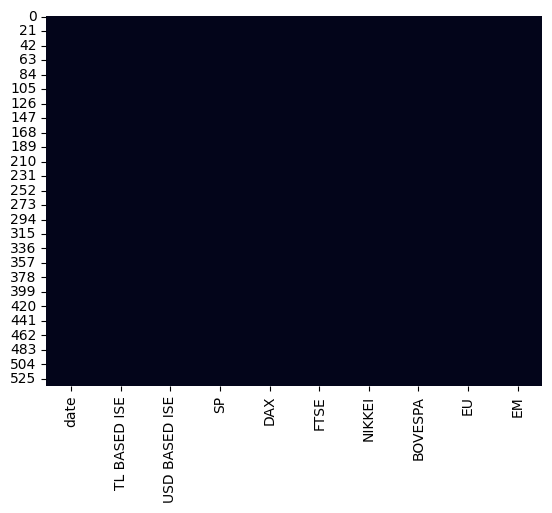

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(df.isna(), cbar=False)

Let's say we want to predict USD Based ISE.

In [ ]:
df.set_index('date', inplace=True)
df = df.rename(columns={'USD BASED ISE': 'Y'})

In [ ]:
df.head(4)

,TL BASED ISE,Y,SP,DAX,FTSE,NIKKEI,BOVESPA,EU,EM
date,,,,,,,,,
2009-01-05,0.035754,0.038376,-0.004679,0.002193,0.003894,0.000000,0.031190,0.012698,0.028524
2009-01-06,0.025426,0.031813,0.007787,0.008455,0.012866,0.004162,0.018920,0.011341,0.008773
2009-01-07,-0.028862,-0.026353,-0.030469,-0.017833,-0.028735,0.017293,-0.035899,-0.017073,-0.020015
2009-01-08,-0.062208,-0.084716,0.003391,-0.011726,-0.000466,-0.040061,0.028283,-0.005561,-0.019424


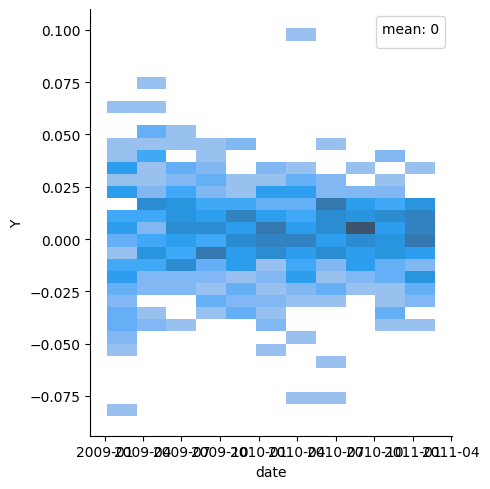

In [ ]:
sns.displot(data=df, x='date', y='Y')
plt.legend(title='mean: {:,.0f}'.format(df["Y"].mean()), labels=[])
plt.show()

Let's generate samples, train and test set:

In [ ]:
from sklearn.model_selection import train_test_split

# Shift the 'Y' column by 1 to get the past values of 'Y' and create a new column named 'past_Y'
df['past_Y'] = df['Y'].shift(1)

features = df.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1


# Fill the NaN value at the first row with a suitable initial value (e.g., mean)
initial_value = df['Y'].mean()
df['past_Y'].fillna(initial_value, inplace=True)


# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df) - window_size+1, stride):
    # extract the input features including the 'past_Y' values for this window
    X = df.iloc[i:i+window_size, df.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)

Now the model:

In [ ]:
from keras.models import Sequential
from keras.layers import Conv1D, MaxPooling1D, Flatten, Dense

n_samples = X_train.shape[0]
n_timesteps = X_train.shape[1]
n_features = X_train.shape[2]
model = Sequential()
model.add(Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(n_timesteps, n_features)))
model.add(MaxPooling1D(pool_size=2))
model.add(Flatten())
model.add(Dense(4, activation='relu'))
model.add(Dense(1))

model.compile(optimizer='adam', loss='mse')

In [ ]:
model.fit(X_train, y_train, epochs=100, batch_size=128, validation_data=(X_test, y_test), verbose=1)

Epoch 1/100
4/4 [==============================] - 0s 25ms/step - loss: 4.9046e-04 - val_loss: 2.7195e-04
Epoch 2/100
4/4 [==============================] - 0s 5ms/step - loss: 4.6000e-04 - val_loss: 2.7390e-04
Epoch 3/100
4/4 [==============================] - 0s 5ms/step - loss: 4.5944e-04 - val_loss: 2.8145e-04
Epoch 4/100
4/4 [==============================] - 0s 5ms/step - loss: 4.5815e-04 - val_loss: 2.8992e-04
Epoch 5/100
4/4 [==============================] - 0s 5ms/step - loss: 4.5427e-04 - val_loss: 2.9231e-04
Epoch 6/100
4/4 [==============================] - 0s 5ms/step - loss: 4.4786e-04 - val_loss: 2.8585e-04
Epoch 7/100
4/4 [==============================] - 0s 5ms/step - loss: 4.4223e-04 - val_loss: 2.9301e-04
Epoch 8/100
4/4 [==============================] - 0s 5ms/step - loss: 4.3749e-04 - val_loss: 2.8966e-04
Epoch 9/100
4/4 [==============================] - 0s 5ms/step - loss: 4.2993e-04 - val_loss: 2.9859e-04
Epoch 10/100
4/4 [==============================] - 0s

In [ ]:
y_pred = model.predict(X_test)
print(y_pred)

4/4 [==============================] - 0s 688us/step
[[ 0.01053962]
 [ 0.00012981]
 [-0.00428446]
 [-0.00075702]
 [ 0.00415684]
 [ 0.00418986]
 [-0.00407338]
 [ 0.00169813]
 [ 0.00574274]
 [ 0.00263129]
 [ 0.00552244]
 [-0.01154474]
 [-0.00922932]
 [-0.00775388]
 [ 0.00113815]
 [ 0.01164614]
 [ 0.00445626]
 [ 0.01642024]
 [-0.01115198]
 [-0.01399513]
 [ 0.01202058]
 [ 0.01411522]
 [-0.00540541]
 [ 0.01042689]
 [ 0.01039822]
 [-0.00010267]
 [-0.0002592 ]
 [ 0.00659596]
 [ 0.01106028]
 [-0.00258156]
 [-0.01155763]
 [-0.01129444]
 [ 0.0035651 ]
 [-0.00038291]
 [-0.01166034]
 [ 0.00479202]
 [ 0.01859538]
 [ 0.00734858]
 [-0.00133026]
 [ 0.00233724]
 [ 0.00867035]
 [ 0.0076378 ]
 [-0.01333397]
 [-0.01671304]
 [ 0.01685381]
 [ 0.00493307]
 [-0.00144755]
 [-0.01325655]
 [-0.0012746 ]
 [ 0.01257435]
 [ 0.01035196]
 [ 0.00760312]
 [ 0.01096691]
 [-0.00552922]
 [-0.00593546]
 [-0.0050857 ]
 [ 0.0006704 ]
 [-0.00235186]
 [-0.0044214 ]
 [-0.00460636]
 [-0.01568049]
 [-0.00456098]
 [ 0.01563301]
 [

In [ ]:
print(y_pred[20])
print(y_test[20])

[0.01202058]
[-0.00814098]


In [ ]:
print(y_pred[21])
print(y_test[21])

[0.01411522]
[-0.00769588]


In [ ]:
print(mean_absolute_error(y_pred, y_test))

0.01541404725456933


Ok now let's see the LIME explanation:

2813/2813 [==============================] - 1s 385us/step
Bias LIME term: 0.0006834543078018196
('FTSE_t-3 > 0.01', 0.0069389117342514624)
('EM_t-3 > 0.01', -0.005348330579616247)
('NIKKEI_t-1 <= -0.01', 0.005010486391040713)
('BOVESPA_t-4 > 0.01', 0.0031898021380748097)
('TL BASED ISE_t-2 <= -0.01', -0.002963693740116173)
('NIKKEI_t-2 > 0.01', -0.002154047378697698)
('BOVESPA_t-6 > 0.01', 0.0017563208976262975)
('0.00 < EM_t-2 <= 0.01', -0.0015599921715236968)
('TL BASED ISE_t-5 > 0.01', -0.0015345269919227072)
('TL BASED ISE_t-1 > 0.01', 0.0014559521325320363)
('NIKKEI_t-5 <= -0.01', -0.0012820591749753887)
('0.00 < SP_t-3 <= 0.01', -0.0012678083279503186)
('-0.01 < EM_t-1 <= 0.00', 0.001141929267374598)
('-0.01 < FTSE_t-4 <= 0.00', -0.001138123225226658)
('0.00 < BOVESPA_t-1 <= 0.01', 0.0011323496115301015)
('-0.01 < SP_t-5 <= 0.00', -0.0009926508695221124)
('-0.01 < past_Y_t-5 <= 0.00', 0.000986807268374563)
('-0.01 < EM_t-4 <= 0.00', 0.000913468249631303)
('EU_t-3 > 0.01', 0.0008

Based on the LIME explanation, the following features had the most influence on the model's prediction:
FTSE, with a weight of 0.008077,
EM, with a weight of 0.008964,
NIKKEI, with a weight of 0.008447,
BOVESPA, with a weight of 0.006078,
TL BASED ISE, with a weight of 0.005954,
SP, with a weight of 0.003076,
past_Y, with a weight of 0.000987,
EU, with a weight of 0.000847.
The model gave the most importance to the feature FTSE at time step t-3, with a weight of 0.006939
For this specific instance, it looks like the model relies heavily on EM, NIKKEI, FTSE, BOVESPA.


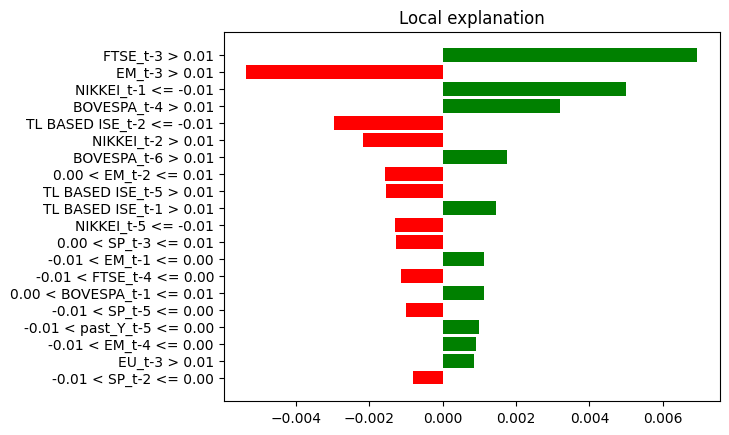

In [ ]:
explain_model(X_train, model, X_test[20], features_names=input_features)

2813/2813 [==============================] - 1s 362us/step
Bias LIME term: 0.0017716860032261832
('FTSE_t-4 > 0.01', 0.006685779036001449)
('past_Y_t-5 > 0.01', -0.005755526317239419)
('EM_t-1 <= -0.01', 0.005216968133518601)
('EM_t-4 > 0.01', -0.00487400654792914)
('TL BASED ISE_t-2 > 0.01', 0.0037955110369927167)
('TL BASED ISE_t-3 <= -0.01', -0.003001156920114274)
('EU_t-4 > 0.01', -0.0027820045341912453)
('NIKKEI_t-2 <= -0.01', 0.0027583340904483084)
('DAX_t-4 > 0.01', -0.0019157919349725965)
('0.00 < EM_t-3 <= 0.01', -0.0014329062610778963)
('0.00 < BOVESPA_t-2 <= 0.01', 0.0012639301502265882)
('0.00 < EU_t-1 <= 0.01', -0.001137021640743327)
('-0.01 < BOVESPA_t-1 <= 0.00', -0.0010997888593414376)
('-0.01 < EM_t-2 <= 0.00', 0.0010983069693907073)
('-0.01 < FTSE_t-3 <= 0.00', -0.0009692839768347648)
('past_Y_t-3 > 0.01', 0.0008406692963245411)
('NIKKEI_t-3 > 0.01', 0.0007678220596068743)
('-0.01 < SP_t-3 <= 0.00', 0.0007624893040125951)
('0.00 < SP_t-1 <= 0.01', 0.000727585382917764

Based on the LIME explanation, the following features had the most influence on the model's prediction:
FTSE, with a weight of 0.007655,
past_Y, with a weight of 0.006596,
EM, with a weight of 0.012622,
TL BASED ISE, with a weight of 0.006797,
EU, with a weight of 0.003919,
NIKKEI, with a weight of 0.004234,
DAX, with a weight of 0.001916,
BOVESPA, with a weight of 0.002364,
SP, with a weight of 0.00149.
The model gave the most importance to the feature FTSE at time step t-4, with a weight of 0.006686
For this specific instance, it looks like the model relies heavily on EM, FTSE, TL BASED ISE, past_Y.


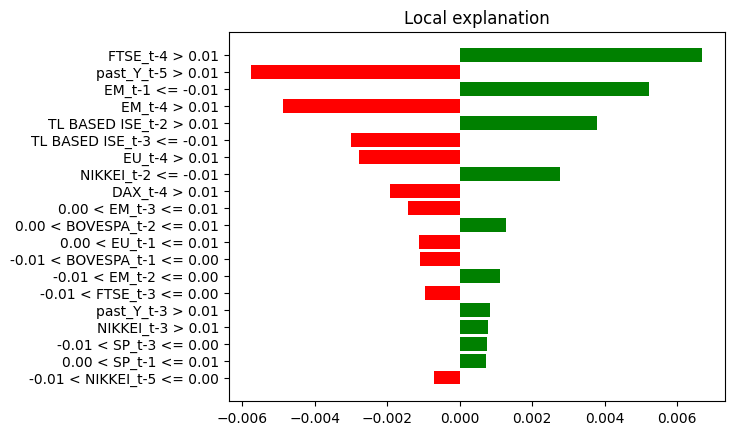

In [ ]:
explain_model(X_train, model, X_test[21], features_names=input_features)

Let's try with LSTM:

In [ ]:
from keras.models import Sequential
from keras.layers import LSTM, Dense

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(64, input_shape=input_shape))
model.add(Dense(1))


model.compile(optimizer='adam', loss='mse')

In [ ]:
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))

Epoch 1/100
14/14 [==============================] - 1s 22ms/step - loss: 4.7715e-04 - val_loss: 2.4570e-04
Epoch 2/100
14/14 [==============================] - 0s 4ms/step - loss: 3.7087e-04 - val_loss: 2.2430e-04
Epoch 3/100
14/14 [==============================] - 0s 3ms/step - loss: 3.0595e-04 - val_loss: 1.8341e-04
Epoch 4/100
14/14 [==============================] - 0s 4ms/step - loss: 2.8741e-04 - val_loss: 1.6689e-04
Epoch 5/100
14/14 [==============================] - 0s 4ms/step - loss: 2.3232e-04 - val_loss: 1.4619e-04
Epoch 6/100
14/14 [==============================] - 0s 3ms/step - loss: 1.9261e-04 - val_loss: 1.5988e-04
Epoch 7/100
14/14 [==============================] - 0s 3ms/step - loss: 1.7486e-04 - val_loss: 1.3870e-04
Epoch 8/100
14/14 [==============================] - 0s 3ms/step - loss: 1.5552e-04 - val_loss: 1.4074e-04
Epoch 9/100
14/14 [==============================] - 0s 3ms/step - loss: 1.5055e-04 - val_loss: 1.1176e-04
Epoch 10/100
14/14 [================

In [ ]:
y_pred = model.predict(X_test)
print(mean_absolute_error(y_pred, y_test))

4/4 [==============================] - 0s 1ms/step
0.004804893111630599


In [ ]:
print(y_pred[19])
print(y_test[19])

[0.00643813]
[0.0076885]


2813/2813 [==============================] - 2s 774us/step
Bias LIME term: -0.0024702437651614394
('TL BASED ISE_t-0 > 0.01', 0.03153543096318304)
('TL BASED ISE_t-1 <= -0.01', -0.004097589258356648)
('NIKKEI_t-1 > 0.01', -0.002606001637212095)
('-0.01 < EM_t-0 <= 0.00', -0.0013030145420615165)
('NIKKEI_t-0 <= -0.01', -0.0012106052879774644)
('-0.01 < EU_t-0 <= 0.00', -0.0009185673637686526)
('FTSE_t-2 > 0.01', 0.0009159152820845069)
('DAX_t-2 > 0.01', -0.0008371427032546015)
('-0.01 < past_Y_t-0 <= 0.00', 0.0008199483223668335)
('EM_t-2 > 0.01', -0.0006861146815560502)
('NIKKEI_t-5 <= -0.01', -0.0006103360815625258)
('NIKKEI_t-4 <= -0.01', -0.0005395636618214017)
('-0.01 < FTSE_t-0 <= 0.00', 0.0005380401990950735)
('0.00 < BOVESPA_t-0 <= 0.01', -0.0004818053550753298)
('-0.01 < SP_t-1 <= 0.00', -0.00044757396402763283)
('TL BASED ISE_t-4 > 0.01', -0.00042663545460705835)
('-0.01 < FTSE_t-5 <= 0.00', -0.00041994056292178774)
('past_Y_t-3 > 0.01', 0.0003795069877785214)
('0.00 < TL BASE

Based on the LIME explanation, the following features had the most influence on the model's prediction:
TL BASED ISE, with a weight of 0.036434,
NIKKEI, with a weight of 0.004967,
EM, with a weight of 0.001989,
EU, with a weight of 0.000919,
FTSE, with a weight of 0.001874,
DAX, with a weight of 0.000837,
past_Y, with a weight of 0.001199,
BOVESPA, with a weight of 0.000813,
SP, with a weight of 0.000448.
The model gave the most importance to the feature TL BASED ISE at time step t-0, with a weight of 0.031535
For this specific instance, it looks like the model relies heavily on TL BASED ISE, NIKKEI, EM, FTSE.


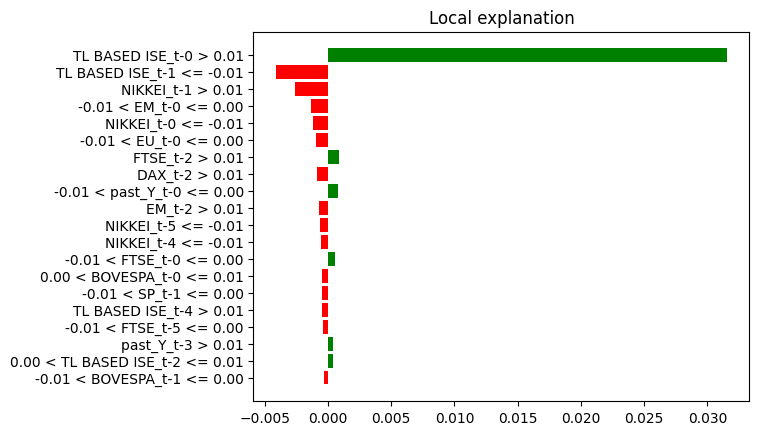

In [ ]:
explain_model(X_train, model, X_test[19], input_features)

2813/2813 [==============================] - 2s 816us/step
Bias LIME term: 0.0019485953114711837
('EM_t-0 <= -0.01', -0.007466878221757275)
('0.00 < TL BASED ISE_t-0 <= 0.01', 0.006220370835006584)
('TL BASED ISE_t-1 > 0.01', 0.004279608620867608)
('NIKKEI_t-1 <= -0.01', 0.0027069411403978613)
('FTSE_t-3 > 0.01', 0.0013256542841076397)
('DAX_t-3 > 0.01', -0.0013036572130408872)
('0.00 < EU_t-0 <= 0.01', 0.0011958580986334193)
('TL BASED ISE_t-2 <= -0.01', -0.0011282400206264645)
('0.00 < past_Y_t-0 <= 0.01', -0.0011225842094330014)
('NIKKEI_t-5 <= -0.01', -0.0007877578384710319)
('TL BASED ISE_t-5 > 0.01', -0.0007755975536584396)
('0.00 < SP_t-1 <= 0.01', 0.0006985816778728225)
('-0.01 < BOVESPA_t-0 <= 0.00', 0.0006693569605988959)
('BOVESPA_t-4 > 0.01', -0.0005121173707203065)
('NIKKEI_t-6 <= -0.01', -0.0005045826011992854)
('0.00 < FTSE_t-0 <= 0.01', -0.0004695461830117471)
('-0.01 < NIKKEI_t-0 <= 0.00', -0.00046183091361138505)
('NIKKEI_t-2 > 0.01', -0.00042378347632335424)
('0.00 <

Based on the LIME explanation, the following features had the most influence on the model's prediction:
EM, with a weight of 0.007467,
TL BASED ISE, with a weight of 0.012404,
NIKKEI, with a weight of 0.004885,
FTSE, with a weight of 0.001795,
DAX, with a weight of 0.001725,
EU, with a weight of 0.001196,
past_Y, with a weight of 0.001487,
SP, with a weight of 0.000699,
BOVESPA, with a weight of 0.001181.
The model gave the most importance to the feature EM at time step t-0, with a weight of -0.007467
For this specific instance, it looks like the model relies heavily on TL BASED ISE, EM, NIKKEI, FTSE.


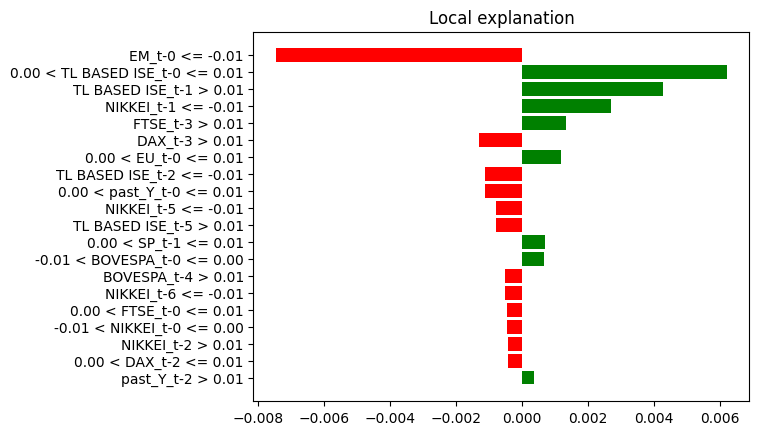

In [ ]:
explain_model(X_train, model, X_test[20], features_names=input_features)

Let's check the xcm model:

In [ ]:
len(X_train)

424


Dataset loaded
Training set size: 424
Testing set size: 106
X_train.shape:  (424, 7, 9, 1)
X_test.shape:  (106, 7, 9, 1)

Training on fold 1
XCM Model Loaded
Epoch 1/100
5/5 [==============================] - 1s 37ms/step - loss: 0.0105 - mean_absolute_error: 0.0836 - val_loss: 4.9874e-04 - val_mean_absolute_error: 0.0178
Epoch 2/100
5/5 [==============================] - 0s 7ms/step - loss: 0.0028 - mean_absolute_error: 0.0414 - val_loss: 4.4398e-04 - val_mean_absolute_error: 0.0161
Epoch 3/100
5/5 [==============================] - 0s 7ms/step - loss: 0.0011 - mean_absolute_error: 0.0256 - val_loss: 4.6805e-04 - val_mean_absolute_error: 0.0165
Epoch 4/100
5/5 [==============================] - 0s 8ms/step - loss: 8.9941e-04 - mean_absolute_error: 0.0234 - val_loss: 5.2709e-04 - val_mean_absolute_error: 0.0175
Epoch 5/100
5/5 [==============================] - 0s 7ms/step - loss: 7.9147e-04 - mean_absolute_error: 0.0233 - val_loss: 4.8969e-04 - val_mean_absolute_error: 0.0169
Epoch 6

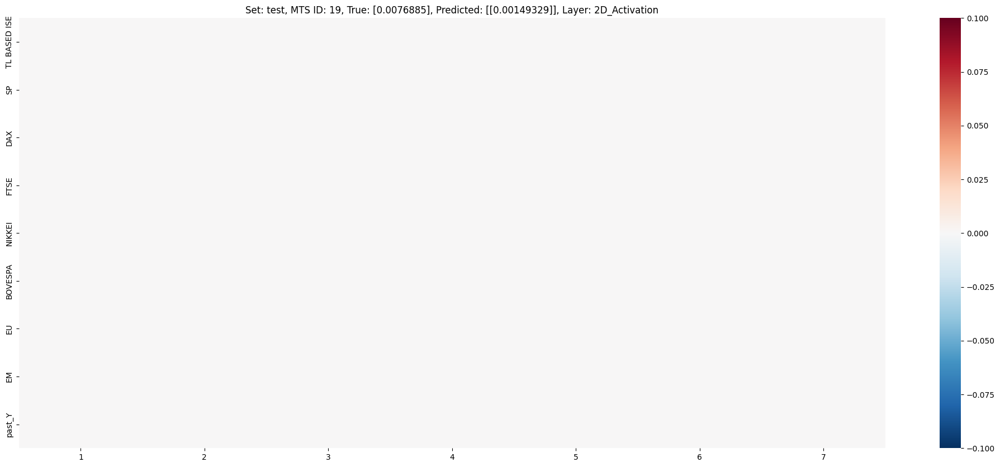

In [ ]:
model_xcm = xcm_start(X_train, y_train, X_test, y_test, yticklabels=input_features)

In [ ]:
X_test.shape

(106, 7, 9)

In [ ]:
X_test_xcm = np.reshape(
    np.array(X_test),
    (X_test.shape[0], X_test.shape[1], X_test.shape[2], 1),
    order="C",
)

model_xcm.predict(X_test_xcm)

4/4 [==============================] - 0s 1ms/step


array([[0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.00149329],
       [0.001

In [ ]:
print(y_test)

[[ 0.00660358]
 [ 0.00032606]
 [ 0.01037803]
 [-0.00688954]
 [ 0.00231497]
 [ 0.01277985]
 [ 0.01594248]
 [ 0.01018349]
 [ 0.00878905]
 [-0.01059654]
 [ 0.00824221]
 [ 0.01130961]
 [ 0.02759418]
 [ 0.00088613]
 [ 0.000196  ]
 [ 0.03779504]
 [ 0.00037387]
 [ 0.01568416]
 [-0.00412852]
 [ 0.0076885 ]
 [-0.00814098]
 [-0.00769588]
 [-0.01132673]
 [ 0.02209617]
 [ 0.00179629]
 [ 0.00852098]
 [-0.00640193]
 [-0.0427355 ]
 [ 0.01443257]
 [-0.00130669]
 [ 0.00703944]
 [ 0.04267029]
 [-0.00437412]
 [-0.00573413]
 [ 0.00852324]
 [-0.01660256]
 [-0.01187706]
 [-0.01733661]
 [ 0.00637886]
 [-0.03563273]
 [-0.03754109]
 [-0.00044865]
 [ 0.00353471]
 [-0.02363106]
 [-0.03477944]
 [ 0.01117932]
 [ 0.0191463 ]
 [ 0.016953  ]
 [ 0.0041029 ]
 [ 0.01035651]
 [ 0.0081574 ]
 [-0.01246241]
 [-0.03185293]
 [-0.02008971]
 [ 0.02218826]
 [ 0.00468932]
 [-0.02670327]
 [-0.01964118]
 [-0.0169853 ]
 [-0.01739167]
 [ 0.01821724]
 [ 0.01217666]
 [ 0.0124789 ]
 [ 0.00423297]
 [ 0.000634  ]
 [ 0.00043838]
 [-0.00558

In [ ]:
X_test_xcm.shape

(106, 7, 9, 1)

In [ ]:
mean_absolute_error(y_test, model_xcm.predict(X_test_xcm))

4/4 [==============================] - 0s 1ms/step


0.012717954556603772

Finally, let's work with a CoVid database:

In [ ]:
df = pd.read_csv("datasetCovidLombardy.csv", parse_dates=["data"], index_col="data")
df.head(3)

,stato,codice_regione,denominazione_regione,lat,long,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,...,note,ingressi_terapia_intensiva,note_test,note_casi,totale_positivi_test_molecolare,totale_positivi_test_antigenico_rapido,tamponi_test_molecolare,tamponi_test_antigenico_rapido,codice_nuts_1,codice_nuts_2
data,,,,,,,,,,,,,,,,,,,,,
2020-02-24 18:00:00,ITA,3,Lombardia,45.466794,9.190347,76,19,95,71,166,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-02-25 18:00:00,ITA,3,Lombardia,45.466794,9.190347,79,25,104,127,231,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2020-02-26 18:00:00,ITA,3,Lombardia,45.466794,9.190347,79,25,104,145,249,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


We can see that there are a lot of useless columns: stato, codice_regione, denominazione_regione, lat, long, codice_nuts_1, codice_nuts_2.

Moreover, we see a lot of NaNs, don't we? Let's see:

<AxesSubplot: ylabel='data'>

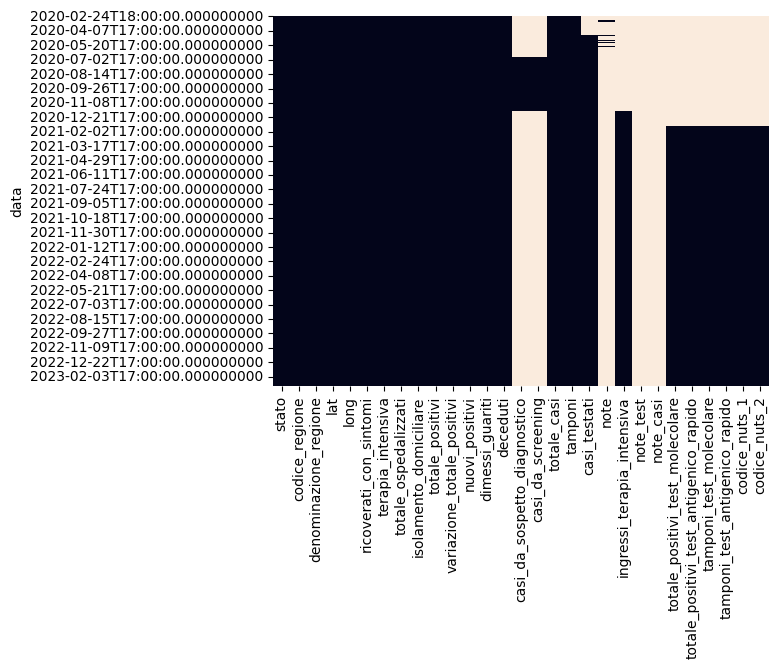

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(df.isna(), cbar = False)

Okay, now that we have a graphical view of this, we can think about deleting some other columns. casi_da_sospetto_diagnostico and casi_da_screening are too few. Same for codice_nuts_1, codice_nuts_2, note, note_test, note_casi. totale_positivi_test_molecolare, totale_positivi_test_antigenico_rapido, tamponi_test_molecolare, tamponi_test_antigenico_rapido could be interesting. Since I have knowledge that prior the first date of the first samples of these, they used only molecular swab, I want to modify these columns in this way:

tamponi_test_antigenico_rapido, totale_positivi_test_antigenico_rapido will be set to 0. tamponi_test_molecolare = tamponi; totale_positivi_test_molecolare = totale_positivi ingressi_terapia_intensiva is not easy, but I think I would set to 0 prior the first insert on this dataset.

In [ ]:
df = df.drop('stato', axis=1)
df = df.drop('codice_regione', axis=1)
df = df.drop('denominazione_regione', axis=1)
df = df.drop('lat', axis=1)
df = df.drop('long', axis=1)
df = df.drop('casi_da_sospetto_diagnostico', axis=1)
df = df.drop('casi_da_screening', axis=1)
df = df.drop('note', axis=1)
df = df.drop('note_test', axis=1)
df = df.drop('note_casi', axis=1)
df = df.drop('codice_nuts_1', axis=1)
df = df.drop('codice_nuts_2', axis=1)
df['tamponi_test_antigenico_rapido'] = df['tamponi_test_antigenico_rapido'].fillna(0)
df['totale_positivi_test_antigenico_rapido'] = df['totale_positivi_test_antigenico_rapido'].fillna(0)
df['ingressi_terapia_intensiva'] = df['ingressi_terapia_intensiva'].fillna(0)
df['casi_testati'] = df['casi_testati'].fillna(0)

df['tamponi_test_molecolare'] = df['tamponi_test_molecolare'].fillna(df['tamponi'])
df['totale_positivi_test_molecolare'] = df['totale_positivi_test_molecolare'].fillna(df['totale_positivi'])
df.head()

,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,variazione_totale_positivi,nuovi_positivi,dimessi_guariti,deceduti,totale_casi,tamponi,casi_testati,ingressi_terapia_intensiva,totale_positivi_test_molecolare,totale_positivi_test_antigenico_rapido,tamponi_test_molecolare,tamponi_test_antigenico_rapido
data,,,,,,,,,,,,,,,,,
2020-02-24 18:00:00,76,19,95,71,166,0,166,0,6,172,1463,0.0,0.0,166.0,0.0,1463.0,0.0
2020-02-25 18:00:00,79,25,104,127,231,65,68,0,9,240,3700,0.0,0.0,231.0,0.0,3700.0,0.0
2020-02-26 18:00:00,79,25,104,145,249,18,18,0,9,258,3208,0.0,0.0,249.0,0.0,3208.0,0.0
2020-02-27 18:00:00,172,41,213,136,349,100,145,40,14,403,3320,0.0,0.0,349.0,0.0,3320.0,0.0
2020-02-28 18:00:00,235,47,282,192,474,125,128,40,17,531,4835,0.0,0.0,474.0,0.0,4835.0,0.0


<AxesSubplot: ylabel='data'>

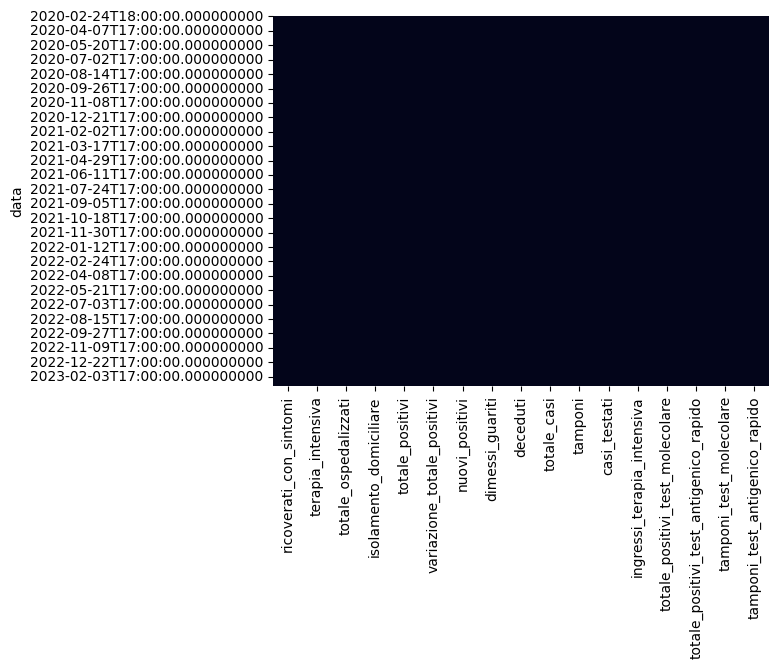

In [ ]:
sns.heatmap(df.isna(), cbar = False)

Ok, now that we are NaN-free, we can move on. Let's set as Y the nuovi positivi column

In [ ]:
df = df.rename(columns={"nuovi_positivi":"Y"})

In [ ]:
df.head()

,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,variazione_totale_positivi,Y,dimessi_guariti,deceduti,totale_casi,tamponi,casi_testati,ingressi_terapia_intensiva,totale_positivi_test_molecolare,totale_positivi_test_antigenico_rapido,tamponi_test_molecolare,tamponi_test_antigenico_rapido
data,,,,,,,,,,,,,,,,,
2020-02-24 18:00:00,76,19,95,71,166,0,166,0,6,172,1463,0.0,0.0,166.0,0.0,1463.0,0.0
2020-02-25 18:00:00,79,25,104,127,231,65,68,0,9,240,3700,0.0,0.0,231.0,0.0,3700.0,0.0
2020-02-26 18:00:00,79,25,104,145,249,18,18,0,9,258,3208,0.0,0.0,249.0,0.0,3208.0,0.0
2020-02-27 18:00:00,172,41,213,136,349,100,145,40,14,403,3320,0.0,0.0,349.0,0.0,3320.0,0.0
2020-02-28 18:00:00,235,47,282,192,474,125,128,40,17,531,4835,0.0,0.0,474.0,0.0,4835.0,0.0


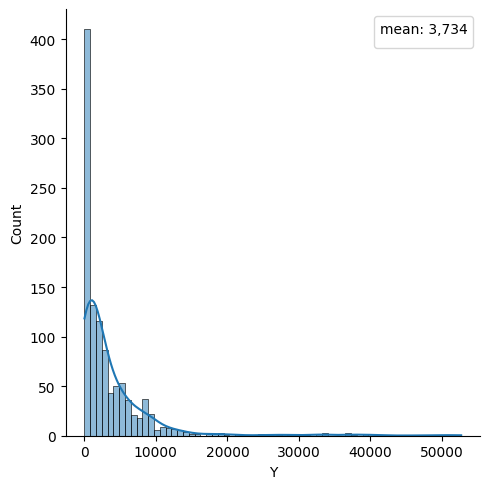

In [ ]:
sns.displot(data=df, x="Y", kde=True)
plt.legend(title="mean: {:,.0f}".format(df["Y"].mean()), labels=[])
plt.show()

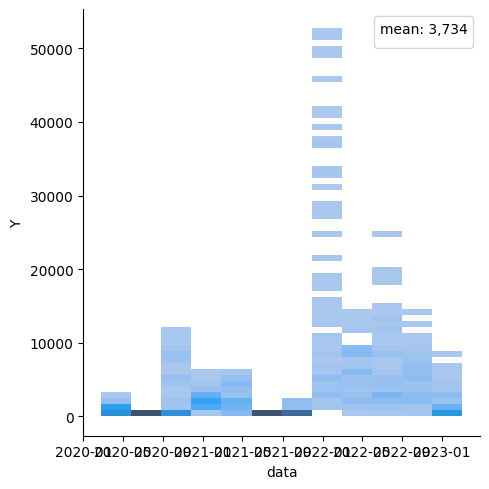

In [ ]:
sns.displot(data=df, x="data", y="Y")
plt.legend(title="mean: {:,.0f}".format(df["Y"].mean()), labels=[])
plt.show()

Now it's time to generate samples. In order to create the samples, let's generate a window of 7 days and try to predict the new positives:

In [ ]:
from sklearn.model_selection import train_test_split

# Shift the 'Y' column by 1 to get the past values of 'Y' and create a new column named 'past_Y'
df['past_Y'] = df['Y'].shift(1)

features = df.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1


# Fill the NaN value at the first row with a suitable initial value (e.g., mean)
initial_value = df['Y'].mean()
df['past_Y'].fillna(initial_value, inplace=True)


# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df) - window_size+1, stride):
    # extract the input features including the 'past_Y' values for this window
    X = df.iloc[i:i+window_size, df.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)

In [ ]:
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau
from sklearn.preprocessing import MinMaxScaler

# Normalize the input data
scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()

X_train = scaler_x.fit_transform(X_train.reshape(-1, X_train.shape[-1])).reshape(X_train.shape)
X_test = scaler_x.transform(X_test.reshape(-1, X_test.shape[-1])).reshape(X_test.shape)
y_train = scaler_y.fit_transform(y_train)
y_test = scaler_y.transform(y_test)

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(100, input_shape=input_shape, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(100, return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(1))

optimizer = Adam(learning_rate=0.01)
model.compile(optimizer=optimizer, loss='mse')

# Adding a learning rate scheduler
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.0001)

history = model.fit(X_train, y_train, epochs=200, batch_size=16, validation_data=(X_test, y_test), callbacks=[lr_scheduler])

# Make predictions using the trained model
y_pred = model.predict(X_test)

# Inverse transform the predictions to the original scale
y_pred = scaler_y.inverse_transform(y_pred)
y_test = scaler_y.inverse_transform(y_test)


Epoch 1/200
55/55 [==============================] - 3s 16ms/step - loss: 0.0387 - val_loss: 0.0065 - lr: 0.0100
Epoch 2/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0084 - val_loss: 0.0027 - lr: 0.0100
Epoch 3/200
55/55 [==============================] - 0s 6ms/step - loss: 0.0055 - val_loss: 0.0026 - lr: 0.0100
Epoch 4/200
55/55 [==============================] - 0s 6ms/step - loss: 0.0059 - val_loss: 0.0068 - lr: 0.0100
Epoch 5/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0052 - val_loss: 0.0028 - lr: 0.0100
Epoch 6/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0051 - val_loss: 0.0022 - lr: 0.0100
Epoch 7/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0055 - val_loss: 0.0057 - lr: 0.0100
Epoch 8/200
55/55 [==============================] - 0s 8ms/step - loss: 0.0053 - val_loss: 0.0034 - lr: 0.0100
Epoch 9/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0042 - val_loss: 0.0024 - lr

In [ ]:
print(y_pred)

[[11264.416 ]
 [ 8509.723 ]
 [ 6753.112 ]
 [ 5557.187 ]
 [ 4822.7256]
 [ 3859.3997]
 [ 3733.1318]
 [ 6671.286 ]
 [ 5148.4204]
 [ 5003.9   ]
 [ 4304.8716]
 [ 3781.307 ]
 [ 3258.787 ]
 [ 2874.5664]
 [ 4703.0576]
 [ 4047.724 ]
 [ 3904.6523]
 [ 3400.0422]
 [ 3282.9062]
 [ 2654.318 ]
 [ 2334.7222]
 [ 3617.2034]
 [ 2738.6814]
 [ 3539.9644]
 [ 3242.4128]
 [ 2999.1248]
 [ 2678.5232]
 [ 2306.2212]
 [ 2552.7913]
 [ 4631.4907]
 [ 3555.3562]
 [ 3360.9294]
 [ 3393.6475]
 [ 3157.647 ]
 [ 3290.166 ]
 [ 4369.534 ]
 [ 4244.0923]
 [ 3819.6047]
 [ 3846.1035]
 [ 3529.494 ]
 [ 3252.269 ]
 [ 3274.4893]
 [ 4227.2437]
 [ 4052.5212]
 [ 3674.5103]
 [ 3485.4512]
 [ 3094.9702]
 [ 2940.7646]
 [ 2984.0212]
 [ 3792.3855]
 [ 3899.1348]
 [ 3676.466 ]
 [ 3498.464 ]
 [ 3634.2349]
 [ 3145.95  ]
 [ 3089.5815]
 [ 4513.411 ]
 [ 4489.37  ]
 [ 4237.0996]
 [ 3986.3728]
 [ 3558.5857]
 [ 3399.3433]
 [ 4361.2974]
 [ 5144.4478]
 [ 5655.1304]
 [ 5482.4536]
 [ 5269.449 ]
 [ 5038.565 ]
 [ 4889.7783]
 [ 5577.2983]
 [ 8385.943 ]
 [ 846

In [ ]:
print(y_test)

[[13130.]
 [ 8605.]
 [ 7669.]
 [ 6847.]
 [ 6146.]
 [ 4549.]
 [ 1721.]
 [ 8860.]
 [ 5572.]
 [ 5369.]
 [ 4692.]
 [ 4328.]
 [ 3145.]
 [ 1169.]
 [ 5474.]
 [ 3740.]
 [ 3224.]
 [ 2975.]
 [ 2813.]
 [ 2143.]
 [  947.]
 [  783.]
 [ 4654.]
 [ 3029.]
 [ 2762.]
 [ 2799.]
 [ 2235.]
 [ 1042.]
 [ 4918.]
 [ 3322.]
 [ 3099.]
 [ 3017.]
 [ 2973.]
 [ 2366.]
 [ 1042.]
 [ 4875.]
 [ 3137.]
 [ 2972.]
 [ 2757.]
 [ 2511.]
 [ 1862.]
 [  738.]
 [ 3980.]
 [ 2733.]
 [ 2554.]
 [ 2420.]
 [ 2310.]
 [ 1851.]
 [  778.]
 [ 4364.]
 [ 2871.]
 [ 3004.]
 [ 3110.]
 [ 2868.]
 [  284.]
 [ 2243.]
 [ 5570.]
 [ 3525.]
 [ 3841.]
 [ 3661.]
 [ 4081.]
 [ 3120.]
 [ 1452.]
 [ 8978.]
 [ 6546.]
 [ 6872.]
 [ 6252.]
 [ 5991.]
 [ 4896.]
 [ 1847.]
 [12249.]
 [ 8498.]
 [ 9124.]
 [ 8699.]
 [ 8671.]
 [ 6231.]
 [ 2229.]
 [14025.]
 [ 9126.]
 [ 8771.]
 [ 7991.]
 [ 7701.]
 [ 5653.]
 [ 1864.]
 [12757.]
 [ 8230.]
 [ 7983.]
 [ 6803.]
 [ 6161.]
 [ 4646.]
 [ 1640.]
 [ 9979.]
 [ 6216.]
 [ 6173.]
 [ 5504.]
 [ 4989.]
 [ 3260.]
 [ 1150.]
 [ 6242.]
 [ 1201.]


In [ ]:
print(mean_absolute_error(y_pred, y_test))

1407.1640269886364


In [ ]:
print(y_pred[50])

[3899.1348]


In [ ]:
print(y_pred[51])

[3676.466]


2813/2813 [==============================] - 7s 2ms/step
Bias LIME term: 0.12684441098402488
('past_Y_t-0 > 0.08', 0.06915143207346411)
('0.03 < past_Y_t-6 <= 0.08', -0.035200350996141355)
('totale_positivi_test_antigenico_rapido_t-6 > 0.05', -0.027272658774584076)
('tamponi_test_antigenico_rapido_t-6 > 0.41', 0.0243212117513326)
('0.03 < past_Y_t-5 <= 0.08', -0.02032813493037164)
('totale_positivi_test_antigenico_rapido_t-5 > 0.05', -0.01806069004068076)
('tamponi_test_antigenico_rapido_t-5 > 0.41', 0.0172339013891971)
('totale_positivi_test_antigenico_rapido_t-0 > 0.06', 0.016097942392719833)
('totale_positivi_test_antigenico_rapido_t-4 > 0.05', -0.013421074601625475)
('variazione_totale_positivi_t-0 > 0.53', 0.012457332756647125)
('0.02 < ricoverati_con_sintomi_t-6 <= 0.09', 0.012085683505662883)
('0.02 < totale_positivi_t-0 <= 0.07', -0.012040252479197107)
('casi_testati_t-0 > 0.75', -0.012001498855887936)
('0.02 < isolamento_domiciliare_t-0 <= 0.06', -0.0118460606287454)
('tamponi

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 0.13427,
totale_positivi_test_antigenico_rapido, with a weight of 0.074852,
tamponi_test_antigenico_rapido, with a weight of 0.064112,
variazione_totale_positivi, with a weight of 0.023459,
ricoverati_con_sintomi, with a weight of 0.012086,
totale_positivi, with a weight of 0.01204,
casi_testati, with a weight of 0.012001,
isolamento_domiciliare, with a weight of 0.011846,
deceduti, with a weight of 0.02184.
The model gave the most importance to the feature past_Y at time step t-0, with a weight of 0.069151
For this specific instance, it looks like the model relies heavily on past_Y, totale_positivi_test_antigenico_rapido, tamponi_test_antigenico_rapido, variazione_totale_positivi.


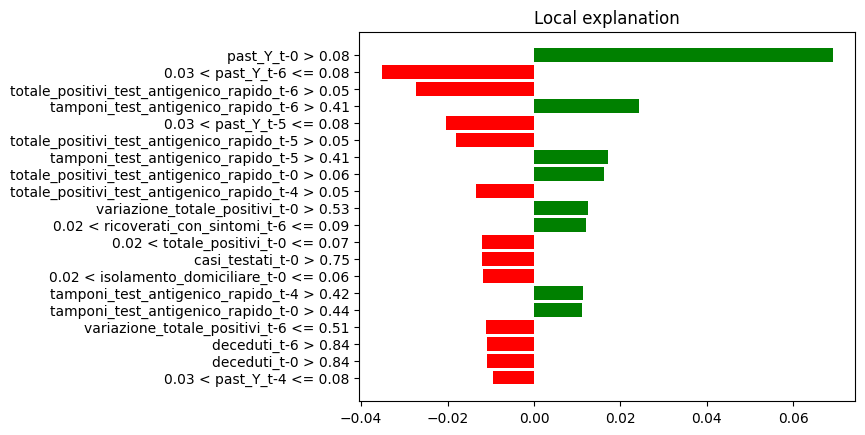

In [ ]:
explain_model(X_train, model, X_test[50], input_features)

2813/2813 [==============================] - 7s 2ms/step
Bias LIME term: 0.15406063965622574
('0.03 < past_Y_t-6 <= 0.08', -0.03485015030297945)
('totale_positivi_test_antigenico_rapido_t-6 > 0.05', -0.02635035550453749)
('tamponi_test_antigenico_rapido_t-6 > 0.41', 0.024841042692831685)
('totale_positivi_test_antigenico_rapido_t-5 > 0.05', -0.02043188819646714)
('0.03 < past_Y_t-5 <= 0.08', -0.018186736974326528)
('tamponi_test_antigenico_rapido_t-5 > 0.41', 0.01656719220025235)
('totale_positivi_test_antigenico_rapido_t-0 > 0.06', 0.015808936837096135)
('0.03 < past_Y_t-0 <= 0.08', -0.01534950192688034)
('totale_positivi_test_antigenico_rapido_t-4 > 0.05', -0.013346340455847993)
('casi_testati_t-0 > 0.75', -0.01313108533040914)
('variazione_totale_positivi_t-0 <= 0.51', -0.012589025559301763)
('0.02 < totale_positivi_t-0 <= 0.07', -0.011781789417076428)
('variazione_totale_positivi_t-6 <= 0.51', -0.011574047165193328)
('0.02 < ricoverati_con_sintomi_t-6 <= 0.09', 0.011461061166352064

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 0.078303,
totale_positivi_test_antigenico_rapido, with a weight of 0.075938,
tamponi_test_antigenico_rapido, with a weight of 0.063155,
casi_testati, with a weight of 0.013131,
variazione_totale_positivi, with a weight of 0.024163,
totale_positivi, with a weight of 0.011782,
ricoverati_con_sintomi, with a weight of 0.011461,
deceduti, with a weight of 0.021582,
isolamento_domiciliare, with a weight of 0.011308.
The model gave the most importance to the feature past_Y at time step t-6, with a weight of -0.03485
For this specific instance, it looks like the model relies heavily on past_Y, totale_positivi_test_antigenico_rapido, tamponi_test_antigenico_rapido, variazione_totale_positivi.


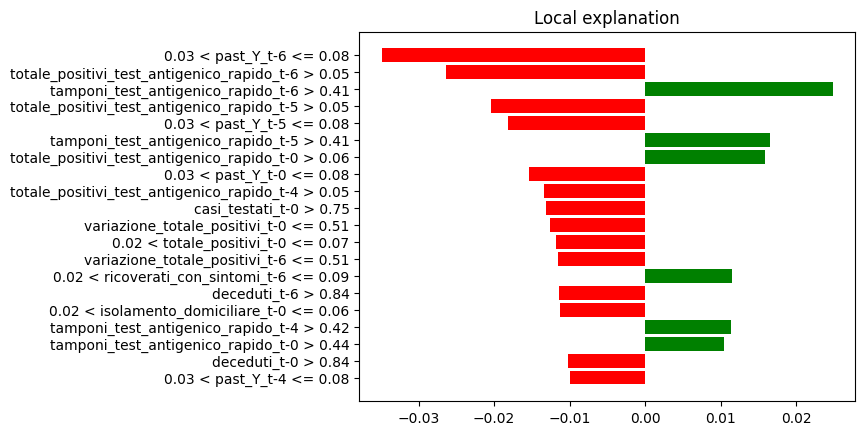

In [ ]:
explain_model(X_train, model, X_test[51], input_features)

Again, the features that have the same threshold have basically the same weight. Instead, the features that are in another threshold could have quite different weights. For example:

past_Y_t-0 (different threshold): 0.04688595961668099 vs -0.010033163438212275
past_Y_t-1 (different threshold):  -0.010599422495833618 vs 0.02781955987268119



We can notice that some feature do not seem to be important. For example, totale ospedalizzati or isolamento domiciliare do not appear in the top 20 features. Let's try to reconstruct the model without those features.

In [ ]:
df.head()

,ricoverati_con_sintomi,terapia_intensiva,totale_ospedalizzati,isolamento_domiciliare,totale_positivi,variazione_totale_positivi,Y,dimessi_guariti,deceduti,totale_casi,tamponi,casi_testati,ingressi_terapia_intensiva,totale_positivi_test_molecolare,totale_positivi_test_antigenico_rapido,tamponi_test_molecolare,tamponi_test_antigenico_rapido,past_Y
data,,,,,,,,,,,,,,,,,,
2020-02-24 18:00:00,76,19,95,71,166,0,166,0,6,172,1463,0.0,0.0,166.0,0.0,1463.0,0.0,3733.788758
2020-02-25 18:00:00,79,25,104,127,231,65,68,0,9,240,3700,0.0,0.0,231.0,0.0,3700.0,0.0,166.000000
2020-02-26 18:00:00,79,25,104,145,249,18,18,0,9,258,3208,0.0,0.0,249.0,0.0,3208.0,0.0,68.000000
2020-02-27 18:00:00,172,41,213,136,349,100,145,40,14,403,3320,0.0,0.0,349.0,0.0,3320.0,0.0,18.000000
2020-02-28 18:00:00,235,47,282,192,474,125,128,40,17,531,4835,0.0,0.0,474.0,0.0,4835.0,0.0,145.000000


In [ ]:
df = df.drop('totale_ospedalizzati', axis=1)
df = df.drop('isolamento_domiciliare', axis=1)

Now let's recreate the train set, test set, compile and fit the model:

In [ ]:
from sklearn.model_selection import train_test_split

# Shift the 'Y' column by 1 to get the past values of 'Y' and create a new column named 'past_Y'
df['past_Y'] = df['Y'].shift(1)

features = df.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1


# Fill the NaN value at the first row with a suitable initial value (e.g., mean)
initial_value = df['Y'].mean()
df['past_Y'].fillna(initial_value, inplace=True)


# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df) - window_size+1, stride):
    # extract the input features including the 'past_Y' values for this window
    X = df.iloc[i:i+window_size, df.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)

In [ ]:
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau
from sklearn.preprocessing import MinMaxScaler

# Normalize the input data
scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()

X_train = scaler_x.fit_transform(X_train.reshape(-1, X_train.shape[-1])).reshape(X_train.shape)
X_test = scaler_x.transform(X_test.reshape(-1, X_test.shape[-1])).reshape(X_test.shape)
y_train = scaler_y.fit_transform(y_train)
y_test = scaler_y.transform(y_test)

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(100, input_shape=input_shape, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(100, return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(1))

optimizer = Adam(learning_rate=0.01)
model.compile(optimizer=optimizer, loss='mse')

# Adding a learning rate scheduler
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.0001)

history = model.fit(X_train, y_train, epochs=200, batch_size=16, validation_data=(X_test, y_test), callbacks=[lr_scheduler])

# Make predictions using the trained model
y_pred = model.predict(X_test)
# Inverse transform the predictions to the original scale
y_pred = scaler_y.inverse_transform(y_pred)
y_test = scaler_y.inverse_transform(y_test)

Epoch 1/200
55/55 [==============================] - 3s 21ms/step - loss: 0.0468 - val_loss: 0.0027 - lr: 0.0100
Epoch 2/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0068 - val_loss: 0.0077 - lr: 0.0100
Epoch 3/200
55/55 [==============================] - 0s 8ms/step - loss: 0.0064 - val_loss: 0.0082 - lr: 0.0100
Epoch 4/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0067 - val_loss: 0.0045 - lr: 0.0100
Epoch 5/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0044 - val_loss: 0.0022 - lr: 0.0100
Epoch 6/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0037 - val_loss: 0.0023 - lr: 0.0100
Epoch 7/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0042 - val_loss: 0.0021 - lr: 0.0100
Epoch 8/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0040 - val_loss: 0.0062 - lr: 0.0100
Epoch 9/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0050 - val_loss: 0.0021 - lr

In [ ]:
print(y_pred)

[[12378.623 ]
 [ 9040.285 ]
 [ 8326.532 ]
 [ 6675.255 ]
 [ 6347.4297]
 [ 5019.253 ]
 [ 4659.2236]
 [ 8328.418 ]
 [ 5955.786 ]
 [ 6049.681 ]
 [ 5445.0645]
 [ 5097.6772]
 [ 4248.949 ]
 [ 3795.5244]
 [ 6009.9604]
 [ 4670.1045]
 [ 4757.3345]
 [ 4271.2026]
 [ 4171.5913]
 [ 3610.7263]
 [ 3204.199 ]
 [ 4457.027 ]
 [ 3664.564 ]
 [ 3990.5767]
 [ 3928.656 ]
 [ 3738.1445]
 [ 3413.497 ]
 [ 3095.9668]
 [ 3237.5898]
 [ 5060.1807]
 [ 4284.4688]
 [ 4136.81  ]
 [ 4112.3193]
 [ 3851.0166]
 [ 3888.5264]
 [ 4966.8003]
 [ 4689.525 ]
 [ 4500.9033]
 [ 4427.4277]
 [ 4282.8237]
 [ 3887.4614]
 [ 3807.8835]
 [ 4770.0464]
 [ 4467.7144]
 [ 4266.5073]
 [ 4087.0645]
 [ 3809.0312]
 [ 3580.006 ]
 [ 3550.0796]
 [ 4371.028 ]
 [ 4304.805 ]
 [ 4263.275 ]
 [ 4138.319 ]
 [ 4242.917 ]
 [ 3901.776 ]
 [ 3669.5815]
 [ 4910.2705]
 [ 4753.2954]
 [ 4844.292 ]
 [ 4619.2363]
 [ 4299.728 ]
 [ 3928.607 ]
 [ 4914.2095]
 [ 5707.8325]
 [ 5794.3477]
 [ 6128.259 ]
 [ 6030.0024]
 [ 5984.7593]
 [ 5535.3965]
 [ 5888.996 ]
 [ 8597.304 ]
 [ 847

In [ ]:
print(y_test)

[[13130.]
 [ 8605.]
 [ 7669.]
 [ 6847.]
 [ 6146.]
 [ 4549.]
 [ 1721.]
 [ 8860.]
 [ 5572.]
 [ 5369.]
 [ 4692.]
 [ 4328.]
 [ 3145.]
 [ 1169.]
 [ 5474.]
 [ 3740.]
 [ 3224.]
 [ 2975.]
 [ 2813.]
 [ 2143.]
 [  947.]
 [  783.]
 [ 4654.]
 [ 3029.]
 [ 2762.]
 [ 2799.]
 [ 2235.]
 [ 1042.]
 [ 4918.]
 [ 3322.]
 [ 3099.]
 [ 3017.]
 [ 2973.]
 [ 2366.]
 [ 1042.]
 [ 4875.]
 [ 3137.]
 [ 2972.]
 [ 2757.]
 [ 2511.]
 [ 1862.]
 [  738.]
 [ 3980.]
 [ 2733.]
 [ 2554.]
 [ 2420.]
 [ 2310.]
 [ 1851.]
 [  778.]
 [ 4364.]
 [ 2871.]
 [ 3004.]
 [ 3110.]
 [ 2868.]
 [  284.]
 [ 2243.]
 [ 5570.]
 [ 3525.]
 [ 3841.]
 [ 3661.]
 [ 4081.]
 [ 3120.]
 [ 1452.]
 [ 8978.]
 [ 6546.]
 [ 6872.]
 [ 6252.]
 [ 5991.]
 [ 4896.]
 [ 1847.]
 [12249.]
 [ 8498.]
 [ 9124.]
 [ 8699.]
 [ 8671.]
 [ 6231.]
 [ 2229.]
 [14025.]
 [ 9126.]
 [ 8771.]
 [ 7991.]
 [ 7701.]
 [ 5653.]
 [ 1864.]
 [12757.]
 [ 8230.]
 [ 7983.]
 [ 6803.]
 [ 6161.]
 [ 4646.]
 [ 1640.]
 [ 9979.]
 [ 6216.]
 [ 6173.]
 [ 5504.]
 [ 4989.]
 [ 3260.]
 [ 1150.]
 [ 6242.]
 [ 1201.]


In [ ]:
print(mean_absolute_error(y_pred, y_test))

1858.7511641068893


In [ ]:
print(y_pred[50])

[4304.805]


In [ ]:
print(y_pred[51])

[4263.275]


In [ ]:
print(mean_absolute_error(y_pred, y_test))

1858.7511641068893


2813/2813 [==============================] - 7s 2ms/step
Bias LIME term: 0.13402789998553524
('past_Y_t-0 > 0.08', 0.062435089802102196)
('0.03 < past_Y_t-6 <= 0.08', -0.04232422610276124)
('0.03 < past_Y_t-5 <= 0.08', -0.02077927613379687)
('tamponi_test_antigenico_rapido_t-0 > 0.44', 0.020634864058711396)
('totale_positivi_test_antigenico_rapido_t-6 > 0.05', -0.018243057831079223)
('0.02 < totale_positivi_t-0 <= 0.07', -0.014391695161474035)
('0.02 < ricoverati_con_sintomi_t-6 <= 0.09', 0.01360245303538389)
('0.03 < past_Y_t-4 <= 0.08', -0.01300990003001767)
('variazione_totale_positivi_t-6 <= 0.51', -0.011231943495336544)
('totale_positivi_test_antigenico_rapido_t-5 > 0.05', -0.010704829142423513)
('totale_positivi_test_antigenico_rapido_t-3 > 0.05', -0.010197931767430493)
('totale_positivi_test_antigenico_rapido_t-4 > 0.05', -0.009854819063773694)
('variazione_totale_positivi_t-0 > 0.53', 0.009798712620647465)
('totale_casi_t-6 > 0.29', -0.009537258308461057)
('0.02 < totale_positi

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 0.138548,
tamponi_test_antigenico_rapido, with a weight of 0.028732,
totale_positivi_test_antigenico_rapido, with a weight of 0.057817,
totale_positivi, with a weight of 0.031122,
ricoverati_con_sintomi, with a weight of 0.013602,
variazione_totale_positivi, with a weight of 0.021031,
totale_casi, with a weight of 0.017476,
casi_testati, with a weight of 0.008895.
The model gave the most importance to the feature past_Y at time step t-0, with a weight of 0.062435
For this specific instance, it looks like the model relies heavily on past_Y, totale_positivi_test_antigenico_rapido, totale_positivi, tamponi_test_antigenico_rapido.


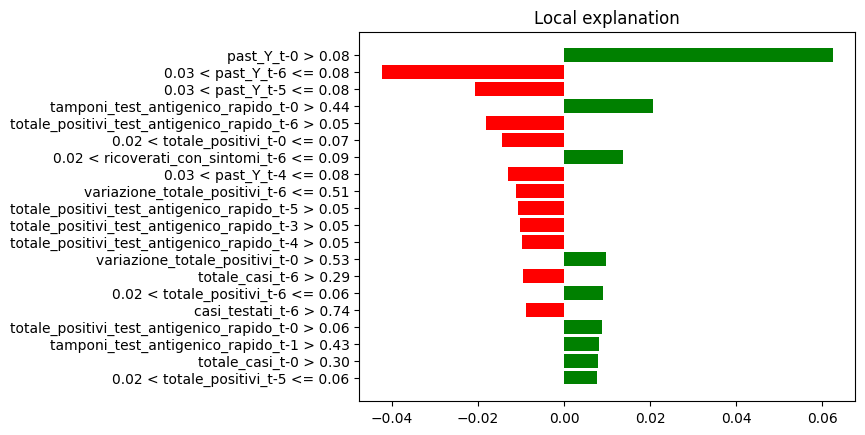

In [ ]:
explain_model(X_train, model, X_test[50], input_features)

2813/2813 [==============================] - 9s 3ms/step
Bias LIME term: 0.1509995707597913
('0.03 < past_Y_t-6 <= 0.08', -0.04308299236677458)
('0.03 < past_Y_t-5 <= 0.08', -0.019455096405522326)
('past_Y_t-1 > 0.08', 0.01944751454284576)
('tamponi_test_antigenico_rapido_t-0 > 0.44', 0.019390238697683356)
('totale_positivi_test_antigenico_rapido_t-6 > 0.05', -0.01900918770938886)
('0.02 < totale_positivi_t-0 <= 0.07', -0.015717475567793893)
('0.02 < ricoverati_con_sintomi_t-6 <= 0.09', 0.013314080493880765)
('0.03 < past_Y_t-0 <= 0.08', -0.013176230986872744)
('0.03 < past_Y_t-4 <= 0.08', -0.011901537934701303)
('totale_casi_t-6 > 0.29', -0.011296608542401363)
('variazione_totale_positivi_t-6 <= 0.51', -0.0112428518189321)
('casi_testati_t-6 > 0.74', -0.010990399749233114)
('totale_positivi_test_antigenico_rapido_t-5 > 0.05', -0.010220013308600638)
('0.02 < totale_positivi_t-6 <= 0.06', 0.009584417706154646)
('tamponi_test_antigenico_rapido_t-1 > 0.43', 0.009295380131315064)
('totale_

Based on the LIME explanation, the following features had the most influence on the model's prediction:
past_Y, with a weight of 0.107063,
tamponi_test_antigenico_rapido, with a weight of 0.028686,
totale_positivi_test_antigenico_rapido, with a weight of 0.056299,
totale_positivi, with a weight of 0.025302,
ricoverati_con_sintomi, with a weight of 0.021188,
totale_casi, with a weight of 0.01926,
variazione_totale_positivi, with a weight of 0.011243,
casi_testati, with a weight of 0.01099.
The model gave the most importance to the feature past_Y at time step t-6, with a weight of -0.043083
For this specific instance, it looks like the model relies heavily on past_Y, totale_positivi_test_antigenico_rapido, tamponi_test_antigenico_rapido, totale_positivi.


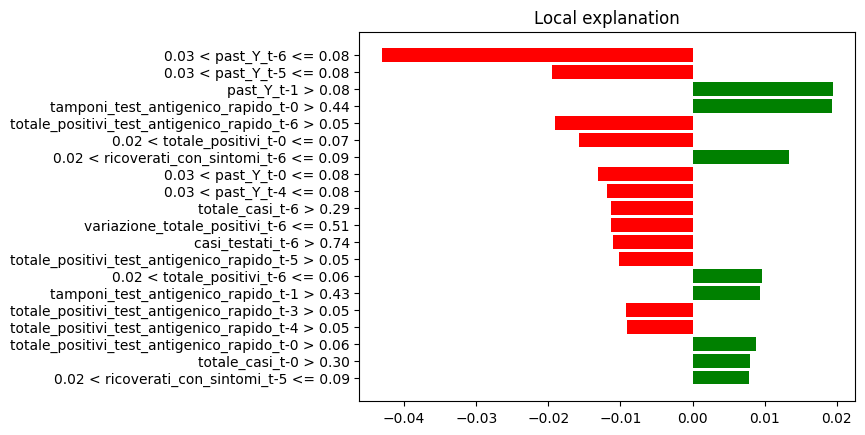

In [ ]:
explain_model(X_train, model, X_test[51], input_features)

New experiment: Divide in 5 parts the Covid database, train the same model over every part and see what happens basically.

In [ ]:
from sklearn.model_selection import KFold

kf = KFold(n_splits=5, shuffle=False)

fold = 1

explanations = []
input_features_list = input_features.tolist()

# Create a new feature list that includes all possible time lags
time_lagged_features = [f"{feature}_t-{i}" for feature in input_features_list for i in range(7)]

for train_index, test_index in kf.split(samples):
    X_train, X_test = samples[train_index], samples[test_index]
    y_train, y_test = labels[train_index], labels[test_index]
    
    # Now you can create and train your model here using X_train, y_train
    # And then test the model using X_test, y_test
    
    # For example
    model.fit(X_train, y_train, epochs=100, batch_size=16, validation_data=(X_test, y_test), callbacks=[lr_scheduler])
    
    y_pred = model.predict(X_test)

    explainer = RecurrentTabularExplainer(X_train, mode='regression', feature_names=input_features)
    for instance in X_test:
        explained = explainer.explain_instance(instance, classifier_fn=model.predict, num_features=15)
        explanations.append(explained)




    # Create a dictionary mapping feature names to indices
    feature_to_index = {feature: index for index, feature in enumerate(time_lagged_features)}

    # Initialize a 2D array of zeros
    feature_importances = np.zeros((len(X_test), len(time_lagged_features)))

    # Fill in the array with feature importances
    for i, exp in enumerate(explanations):

         # If i exceeds the number of rows in feature_importances, create a new array
        if i >= feature_importances.shape[0]:
            feature_importances = np.pad(feature_importances, ((0, len(explanations) - feature_importances.shape[0]), (0, 0)))

        feature_importance_pairs = exp.as_list()

        for feature, importance in feature_importance_pairs:
            # First, we try to match the simpler pattern
            match = re.match(r'([\w_]+_t-\d+)(?: >| <=)? .*', feature)
            
            # If the simpler pattern did not match, we try to match the more complex pattern
            if match is None:
                match = re.match(r'.* ([\w_]+_t-\d+)(?: >| <=)? .*', feature)
            
            if match:
                original_feature = match.group(1)
                feature_index = feature_to_index.get(original_feature)
                if feature_index is not None:
                    feature_importances[i, feature_index] = importance
                else:
                    print(f"Failed to find feature '{original_feature}' in original features")
            else:
                print(f"Failed to extract original feature name from '{feature}'")


            
    # Plot a heatmap of feature importances
    plt.figure(figsize=(25, 25))
    sns.heatmap(feature_importances, xticklabels=time_lagged_features, robust=True)
    plt.xlabel('Feature')
    plt.ylabel('Instance')
    plt.title('Feature importances by instance')
    plt.show()
    
    fold += 1

Epoch 1/100
55/55 [==============================] - 0s 8ms/step - loss: 66366088.0000 - val_loss: 564609.3125 - lr: 1.0000e-04
Epoch 2/100
55/55 [==============================] - 0s 7ms/step - loss: 66325528.0000 - val_loss: 559849.6875 - lr: 1.0000e-04
Epoch 3/100
55/55 [==============================] - 0s 7ms/step - loss: 66297624.0000 - val_loss: 557585.8125 - lr: 1.0000e-04
Epoch 4/100
55/55 [==============================] - 0s 8ms/step - loss: 66280884.0000 - val_loss: 555990.8750 - lr: 1.0000e-04
Epoch 5/100
55/55 [==============================] - 0s 8ms/step - loss: 66268212.0000 - val_loss: 554796.1875 - lr: 1.0000e-04
Epoch 6/100
55/55 [==============================] - 0s 8ms/step - loss: 66257612.0000 - val_loss: 553758.7500 - lr: 1.0000e-04
Epoch 7/100
55/55 [==============================] - 0s 7ms/step - loss: 66248488.0000 - val_loss: 552783.2500 - lr: 1.0000e-04
Epoch 8/100
55/55 [==============================] - 0s 8ms/step - loss: 66239728.0000 - val_loss: 55188

How could we know the features that have an impact for most of the features? We could sort the feature that have most total importance across all samples:

In [ ]:
total_importances = np.abs(feature_importances).sum(axis=0)
top_features_total = total_importances.argsort()[::-1]
top_features_total_list = top_features_total.tolist()
top_feature_names_total = [time_lagged_features[i] for i in top_features_total_list]

In [ ]:
for i in range(20):
    print(top_feature_names_total[i])

tamponi_test_molecolare_t-6
tamponi_t-6
casi_testati_t-6
dimessi_guariti_t-6
tamponi_test_antigenico_rapido_t-6
totale_positivi_test_antigenico_rapido_t-6
totale_casi_t-6
totale_positivi_test_molecolare_t-4
ingressi_terapia_intensiva_t-1
tamponi_t-3
totale_positivi_test_molecolare_t-6
ingressi_terapia_intensiva_t-2
totale_positivi_test_antigenico_rapido_t-3
dimessi_guariti_t-0
terapia_intensiva_t-1
ingressi_terapia_intensiva_t-5
ingressi_terapia_intensiva_t-4
past_Y_t-5
terapia_intensiva_t-3
dimessi_guariti_t-1


We could also organise the feature importance across all the samples in a different way: let's say that we count how many times every feature is non-zero.

In [ ]:
binary_importances = np.where(feature_importances != 0, 1, 0)
importance_counts = binary_importances.sum(axis=0)
top_features_frequency = importance_counts.argsort()[::-1]
top_features_frequency_list = top_features_frequency.tolist()
top_feature_names_frequency = [time_lagged_features[i] for i in top_features_frequency_list]

In [ ]:
for i in range(20):
    print(top_feature_names_frequency[i])

tamponi_test_molecolare_t-6
casi_testati_t-6
tamponi_t-6
dimessi_guariti_t-6
tamponi_test_antigenico_rapido_t-6
totale_positivi_test_antigenico_rapido_t-6
totale_casi_t-6
totale_positivi_test_molecolare_t-6
ingressi_terapia_intensiva_t-1
totale_positivi_test_molecolare_t-4
tamponi_t-3
dimessi_guariti_t-0
dimessi_guariti_t-1
totale_positivi_test_antigenico_rapido_t-3
terapia_intensiva_t-1
ingressi_terapia_intensiva_t-2
past_Y_t-5
totale_positivi_test_molecolare_t-1
ingressi_terapia_intensiva_t-4
dimessi_guariti_t-3


In [5]:
import seaborn as sns
import matplotlib.pyplot as plt

def explain_all_samples(X_train, X_test, model, input_features):

    explanations = []

    input_features_list = input_features.tolist()

    # Create a new feature list that includes all possible time lags
    time_lagged_features = [f"{feature}_t-{i}" for feature in input_features_list for i in range(7)] #TODO mettere in range(X_test.shape(2)) invece di range(7)
    
    explainer = RecurrentTabularExplainer(X_train, mode='regression', feature_names=input_features)
    for instance in X_test:
        explained = explainer.explain_instance(instance, classifier_fn=model.predict, num_features=15)
        explanations.append(explained)




    # Create a dictionary mapping feature names to indices
    feature_to_index = {feature: index for index, feature in enumerate(time_lagged_features)}

    # Initialize a 2D array of zeros
    feature_importances = np.zeros((len(X_test), len(time_lagged_features)))

    # Fill in the array with feature importances
    for i, exp in enumerate(explanations):

         # If i exceeds the number of rows in feature_importances, create a new array
        if i >= feature_importances.shape[0]:
            feature_importances = np.pad(feature_importances, ((0, len(explanations) - feature_importances.shape[0]), (0, 0)))

        feature_importance_pairs = exp.as_list()

        for feature, importance in feature_importance_pairs:
            # First, we try to match the simpler pattern
            match = re.match(r'([\w.\(\)]+_t-\d+)(?: >| <=)? .*', feature)
            
            # If the simpler pattern did not match, we try to match the more complex pattern
            if match is None:
                match = re.match(r'.* ([\w.\(\)]+_t-\d+)(?: >| <=)? .*', feature)
            
            if match:
                original_feature = match.group(1)
                feature_index = feature_to_index.get(original_feature)
                if feature_index is not None:
                    feature_importances[i, feature_index] = importance
                else:
                    print(f"Failed to find feature '{original_feature}' in original features")
            else:
                print(f"Failed to extract original feature name from '{feature}'")


            
    # Plot a heatmap of feature importances
    plt.figure(figsize=(25, 25))
    sns.heatmap(feature_importances, xticklabels=time_lagged_features, robust=True)
    plt.xlabel('Feature')
    plt.ylabel('Instance')
    plt.title('Feature importances by instance')
    plt.show()

    total_importances = np.abs(feature_importances).sum(axis=0)
    top_features_total = total_importances.argsort()[::-1]
    top_features_total_list = top_features_total.tolist()
    top_feature_names_total = [time_lagged_features[i] for i in top_features_total_list]
    print("Top features for value:")
    for i in range(len(top_feature_names_total)):
        print(top_feature_names_total[i])
    binary_importances = np.where(feature_importances != 0, 1, 0)
    importance_counts = binary_importances.sum(axis=0)
    top_features_frequency = importance_counts.argsort()[::-1]
    top_features_frequency_list = top_features_frequency.tolist()
    top_feature_names_frequency = [time_lagged_features[i] for i in top_features_frequency_list]
    print("Top features for presence:")
    for i in range(len(top_feature_names_frequency)):
        print(top_feature_names_frequency[i])
    

Epoch 1/100
234/234 [==============================] - 2s 4ms/step - loss: 322.9330 - val_loss: 42.1137
Epoch 2/100
234/234 [==============================] - 0s 2ms/step - loss: 184.1476 - val_loss: 37.0939
Epoch 3/100
234/234 [==============================] - 0s 2ms/step - loss: 118.9834 - val_loss: 56.0637
Epoch 4/100
234/234 [==============================] - 0s 2ms/step - loss: 86.4197 - val_loss: 74.6096
Epoch 5/100
234/234 [==============================] - 0s 2ms/step - loss: 69.9478 - val_loss: 86.1741
Epoch 6/100
234/234 [==============================] - 0s 2ms/step - loss: 58.8554 - val_loss: 77.7723
Epoch 7/100
234/234 [==============================] - 0s 2ms/step - loss: 51.1354 - val_loss: 70.4281
Epoch 8/100
234/234 [==============================] - 0s 2ms/step - loss: 44.9210 - val_loss: 75.9612
Epoch 9/100
234/234 [==============================] - 0s 2ms/step - loss: 42.8158 - val_loss: 77.6245
Epoch 10/100
234/234 [==============================] - 0s 2ms/step - 

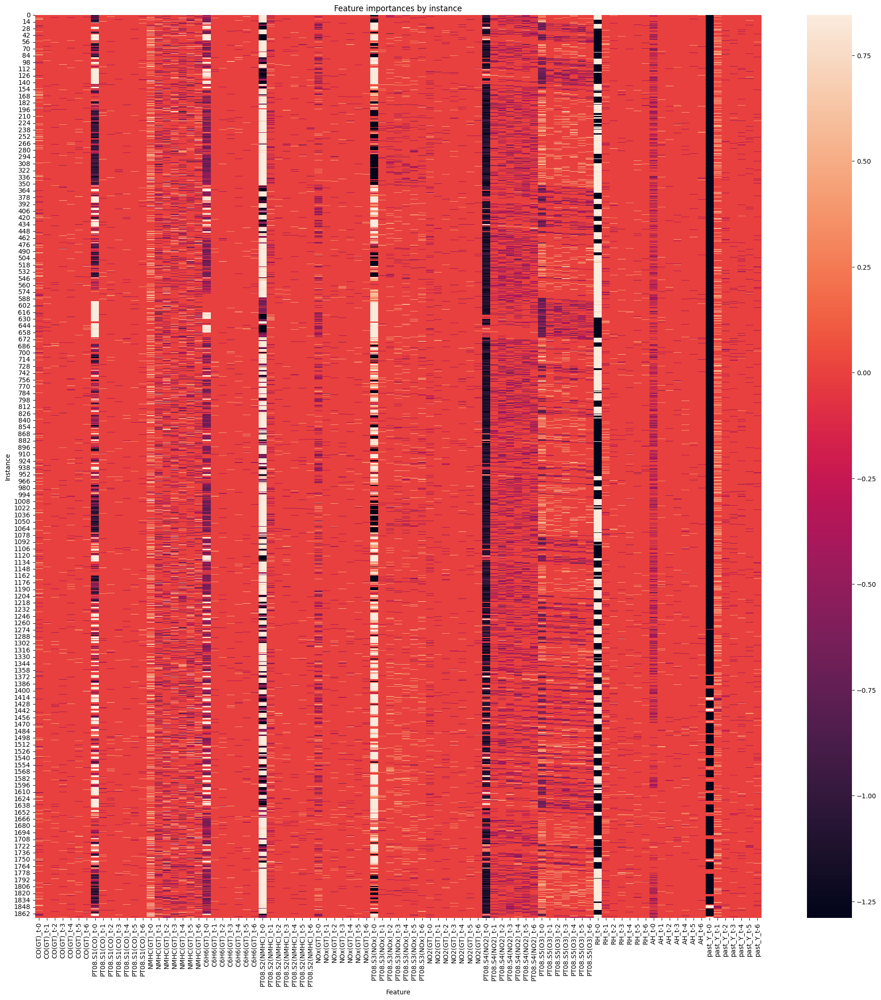

Top features for value:
past_Y_t-0
RH_t-0
PT08.S2(NMHC)_t-0
PT08.S4(NO2)_t-0
PT08.S3(NOx)_t-0
PT08.S1(CO)_t-0
C6H6(GT)_t-0
PT08.S5(O3)_t-0
AH_t-0
NMHC(GT)_t-0
PT08.S4(NO2)_t-2
PT08.S4(NO2)_t-3
NOx(GT)_t-0
NMHC(GT)_t-1
NMHC(GT)_t-2
PT08.S4(NO2)_t-6
PT08.S4(NO2)_t-5
PT08.S4(NO2)_t-4
NMHC(GT)_t-5
NMHC(GT)_t-4
Top features for presence:
RH_t-0
PT08.S2(NMHC)_t-0
past_Y_t-0
PT08.S4(NO2)_t-0
PT08.S3(NOx)_t-0
C6H6(GT)_t-0
PT08.S1(CO)_t-0
PT08.S5(O3)_t-0
AH_t-0
PT08.S4(NO2)_t-2
PT08.S4(NO2)_t-3
PT08.S4(NO2)_t-5
NMHC(GT)_t-0
PT08.S4(NO2)_t-6
NOx(GT)_t-0
PT08.S4(NO2)_t-4
NMHC(GT)_t-1
NMHC(GT)_t-2
NMHC(GT)_t-5
past_Y_t-1


In [20]:
df = pd.read_csv("AirQualityUCI.csv", sep=';')
df = df.drop(['Unnamed: 15', 'Unnamed: 16'], axis=1)
df = df.dropna()
df['CO(GT)'] = df['CO(GT)'].str.replace(',', '.').astype(float)
df['C6H6(GT)'] = df['C6H6(GT)'].str.replace(',', '.').astype(float)
df['T'] = df['T'].str.replace(',', '.').astype(float)
df['RH'] = df['RH'].str.replace(',', '.').astype(float)
df['AH'] = df['AH'].str.replace(',', '.').astype(float)
df = df.rename(columns={'T':'Y'})
df['DateTime'] = pd.to_datetime(df['Date'] + ' ' + df['Time'], format='%d/%m/%Y %H.%M.%S')

df = df.drop(['Date', 'Time'], axis=1)
df.set_index('DateTime', inplace=True)
df.replace(-200, np.nan, inplace=True)
df.interpolate(method='linear', axis=0, inplace=True)
from sklearn.model_selection import train_test_split

# Shift the 'Y' column by 1 to get the past values of 'Y' and create a new column named 'past_Y'
df['past_Y'] = df['Y'].shift(1)

features = df.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1


# Fill the NaN value at the first row with a suitable initial value (e.g., mean)
initial_value = df['Y'].mean()
df['past_Y'].fillna(initial_value, inplace=True)


# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df) - window_size+1, stride):
    # extract the input features including the 'past_Y' values for this window
    X = df.iloc[i:i+window_size, df.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)
from keras.models import Sequential
from keras.layers import LSTM, Dense

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(64, input_shape=input_shape))
model.add(Dense(1))


model.compile(optimizer='adam', loss='mse')
history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_data=(X_test, y_test))
y_pred = model.predict(X_test)

explain_all_samples(X_train, X_test, model, input_features)

Let's do an experiment. Let's use some dataset with only 2 features. Then add some white noises and see what happens when explaining with LIME.

In [25]:
df_weather = pd.read_csv("seattle_weather.csv", sep=',')

<AxesSubplot: >

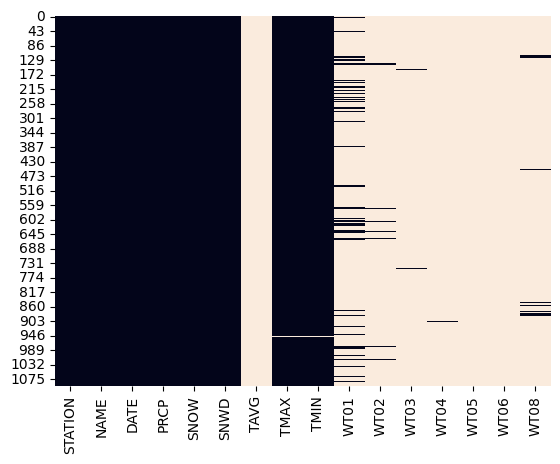

In [26]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.heatmap(df_weather.isna(), cbar=False)

In [29]:
df_weather = df_weather.drop(['STATION', 'NAME', 'SNOW', 'SNWD', 'TAVG', 'TMAX', 'WT01', 'WT02', 'WT03', 'WT04', 'WT05', 'WT06', 'WT08'], axis=1)

In [40]:
df_weather.head()

,PRCP,TMIN
DATE,,
2020-05-17,0.17,54.0
2020-05-18,0.00,50.0
2020-05-19,0.00,52.0
2020-05-20,0.05,51.0
2020-05-21,1.15,47.0


In [31]:
df_weather.interpolate(method='linear', axis=0, inplace=True)

In [33]:
df_weather['DATE'] = pd.to_datetime(df_weather['DATE'])

In [35]:
df_weather.set_index('DATE', inplace=True)

In [41]:
df_weather = df_weather.rename(columns={'TMIN':'Y'})

Now, let's add 5 'noises' features.

In [46]:
for i in range(5):
    df_weather[f'Noise{i+1}'] = np.random.normal(0, 1, len(df_weather))

In [47]:
from sklearn.model_selection import train_test_split

# Shift the 'Y' column by 1 to get the past values of 'Y' and create a new column named 'past_Y'
df_weather['past_Y'] = df_weather['Y'].shift(1)

features = df_weather.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1


# Fill the NaN value at the first row with a suitable initial value (e.g., mean)
initial_value = df_weather['Y'].mean()
df_weather['past_Y'].fillna(initial_value, inplace=True)


# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df_weather) - window_size+1, stride):
    # extract the input features including the 'past_Y' values for this window
    X = df_weather.iloc[i:i+window_size, df_weather.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df_weather.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)

Scale the data, create and train the model.

In [49]:
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau
from sklearn.preprocessing import MinMaxScaler

# Normalize the input data
scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()

X_train = scaler_x.fit_transform(X_train.reshape(-1, X_train.shape[-1])).reshape(X_train.shape)
X_test = scaler_x.transform(X_test.reshape(-1, X_test.shape[-1])).reshape(X_test.shape)
y_train = scaler_y.fit_transform(y_train)
y_test = scaler_y.transform(y_test)

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(100, input_shape=input_shape, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(100, return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(1))

optimizer = Adam(learning_rate=0.01)
model.compile(optimizer=optimizer, loss='mse')

# Adding a learning rate scheduler
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.0001)

history = model.fit(X_train, y_train, epochs=200, batch_size=16, validation_data=(X_test, y_test), callbacks=[lr_scheduler])

# Make predictions using the trained model
y_pred = model.predict(X_test)
# Inverse transform the predictions to the original scale
y_pred = scaler_y.inverse_transform(y_pred)
y_test = scaler_y.inverse_transform(y_test)

Epoch 1/200
55/55 [==============================] - 3s 17ms/step - loss: 0.0596 - val_loss: 0.0103 - lr: 0.0100
Epoch 2/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0101 - val_loss: 0.0091 - lr: 0.0100
Epoch 3/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0106 - val_loss: 0.0090 - lr: 0.0100
Epoch 4/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0087 - val_loss: 0.0185 - lr: 0.0100
Epoch 5/200
55/55 [==============================] - 0s 7ms/step - loss: 0.0112 - val_loss: 0.0075 - lr: 0.0100
Epoch 6/200
55/55 [==============================] - 0s 8ms/step - loss: 0.0071 - val_loss: 0.0069 - lr: 0.0100
Epoch 7/200
55/55 [==============================] - 1s 10ms/step - loss: 0.0077 - val_loss: 0.0064 - lr: 0.0100
Epoch 8/200
55/55 [==============================] - 0s 8ms/step - loss: 0.0067 - val_loss: 0.0057 - lr: 0.0100
Epoch 9/200
55/55 [==============================] - 0s 8ms/step - loss: 0.0068 - val_loss: 0.0057 - l

157/157 [==============================] - 1s 3ms/step


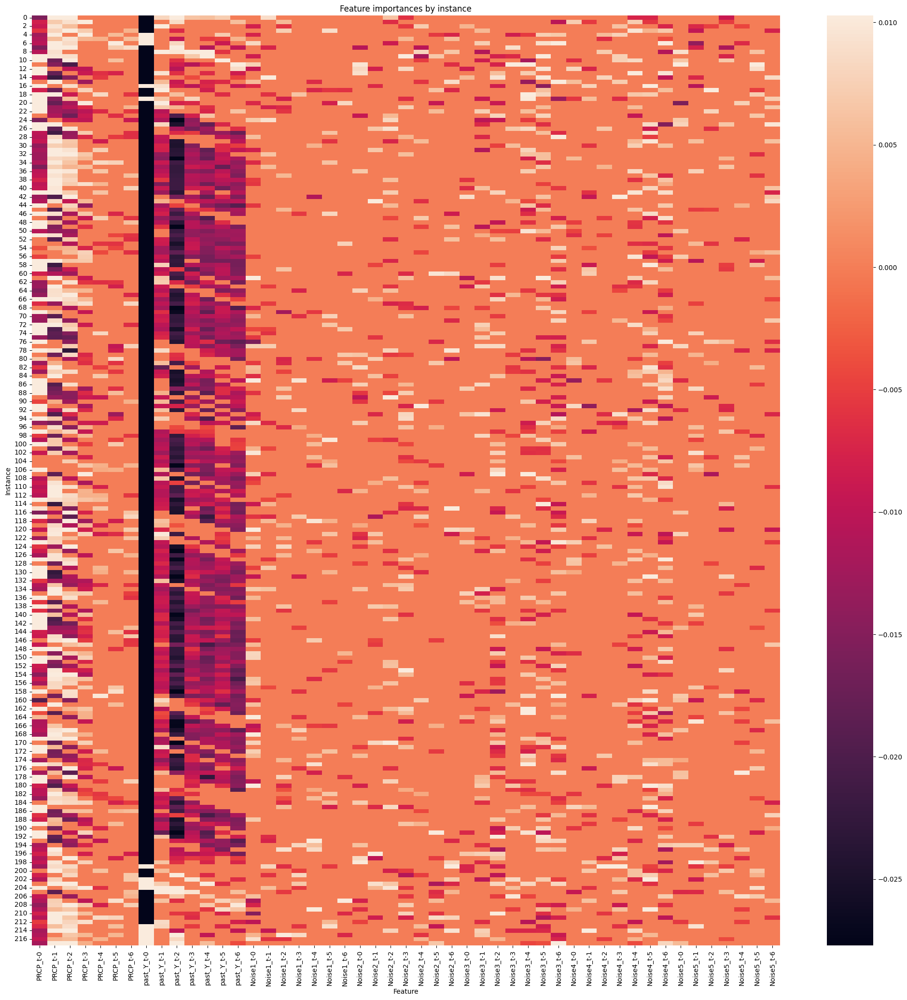

Top features for value:
past_Y_t-0
past_Y_t-2
PRCP_t-0
PRCP_t-1
past_Y_t-4
past_Y_t-6
past_Y_t-3
PRCP_t-2
past_Y_t-5
past_Y_t-1
PRCP_t-3
Noise4_t-6
Noise1_t-0
Noise3_t-6
Noise3_t-2
Noise3_t-5
Noise4_t-5
Noise3_t-4
Noise4_t-4
Noise2_t-3
Top features for presence:
past_Y_t-0
PRCP_t-1
PRCP_t-0
past_Y_t-2
past_Y_t-1
past_Y_t-4
PRCP_t-2
past_Y_t-6
past_Y_t-3
past_Y_t-5
PRCP_t-3
Noise4_t-6
Noise1_t-0
Noise3_t-6
Noise3_t-2
Noise3_t-5
Noise3_t-4
Noise4_t-5
Noise4_t-4
Noise2_t-3


In [52]:
explain_all_samples(X_train, X_test, model, input_features)

Ok, now let's try with the Air Quality dataset:

In [6]:
import pandas as pd
import numpy as np

df_air = pd.read_csv("AirQualityUCI.csv", sep=';')
df_air = df_air.drop(['Unnamed: 15', 'Unnamed: 16'], axis=1)
df_air = df_air.dropna()
df_air['CO(GT)'] = df_air['CO(GT)'].str.replace(',', '.').astype(float)
df_air['C6H6(GT)'] = df_air['C6H6(GT)'].str.replace(',', '.').astype(float)
df_air['T'] = df_air['T'].str.replace(',', '.').astype(float)
df_air['RH'] = df_air['RH'].str.replace(',', '.').astype(float)
df_air['AH'] = df_air['AH'].str.replace(',', '.').astype(float)
df_air = df_air.rename(columns={'CO(GT)':'Y'})
df_air['DateTime'] = pd.to_datetime(df_air['Date'] + ' ' + df_air['Time'], format='%d/%m/%Y %H.%M.%S')


df_air = df_air.drop(['Date', 'Time'], axis=1)
df_air.set_index('DateTime', inplace=True)
df_air.replace(-200, np.nan, inplace=True)
df_air.interpolate(method='linear', axis=0, inplace=True)

# Eliminate the features
df_air = df_air.drop(['T', 'RH', 'AH', 'NMHC(GT)', 'C6H6(GT)', 'PT08.S2(NMHC)', 'NOx(GT)', 'PT08.S3(NOx)', 'PT08.S4(NO2)', 'PT08.S5(O3)',	'RH', 'AH'], axis=1)

# Add noise features
for i in range(5):
    df_air[f'Noise{i+1}'] = np.random.normal(0, 1, len(df_air))

from sklearn.model_selection import train_test_split

features = df_air.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1

# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df_air) - window_size+1, stride):
    # extract the input features
    X = df_air.iloc[i:i+window_size, df_air.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df_air.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)

Now the model:

In [8]:
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau
from sklearn.preprocessing import MinMaxScaler

# Normalize the input data
scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()

X_train = scaler_x.fit_transform(X_train.reshape(-1, X_train.shape[-1])).reshape(X_train.shape)
X_test = scaler_x.transform(X_test.reshape(-1, X_test.shape[-1])).reshape(X_test.shape)
y_train = scaler_y.fit_transform(y_train)
y_test = scaler_y.transform(y_test)

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(100, input_shape=input_shape, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(100, return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(1))

optimizer = Adam(learning_rate=0.01)
model.compile(optimizer=optimizer, loss='mse')

# Adding a learning rate scheduler
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.0001)

history = model.fit(X_train, y_train, epochs=200, batch_size=16, validation_data=(X_test, y_test), callbacks=[lr_scheduler])

# Make predictions using the trained model
y_pred = model.predict(X_test)
# Inverse transform the predictions to the original scale
y_pred = scaler_y.inverse_transform(y_pred)
y_test = scaler_y.inverse_transform(y_test)

Epoch 1/200
468/468 [==============================] - 6s 8ms/step - loss: 0.0113 - val_loss: 0.0116 - lr: 0.0100
Epoch 2/200
468/468 [==============================] - 3s 7ms/step - loss: 0.0047 - val_loss: 0.0061 - lr: 0.0100
Epoch 3/200
468/468 [==============================] - 3s 7ms/step - loss: 0.0044 - val_loss: 0.0092 - lr: 0.0100
Epoch 4/200
468/468 [==============================] - 3s 7ms/step - loss: 0.0043 - val_loss: 0.0056 - lr: 0.0100
Epoch 5/200
468/468 [==============================] - 3s 7ms/step - loss: 0.0044 - val_loss: 0.0129 - lr: 0.0100
Epoch 6/200
468/468 [==============================] - 3s 7ms/step - loss: 0.0041 - val_loss: 0.0256 - lr: 0.0100
Epoch 7/200
468/468 [==============================] - 3s 7ms/step - loss: 0.0044 - val_loss: 0.0108 - lr: 0.0100
Epoch 8/200
468/468 [==============================] - 4s 8ms/step - loss: 0.0043 - val_loss: 0.0089 - lr: 0.0100
Epoch 9/200
468/468 [==============================] - 3s 7ms/step - loss: 0.0041 - val_

157/157 [==============================] - 0s 3ms/step


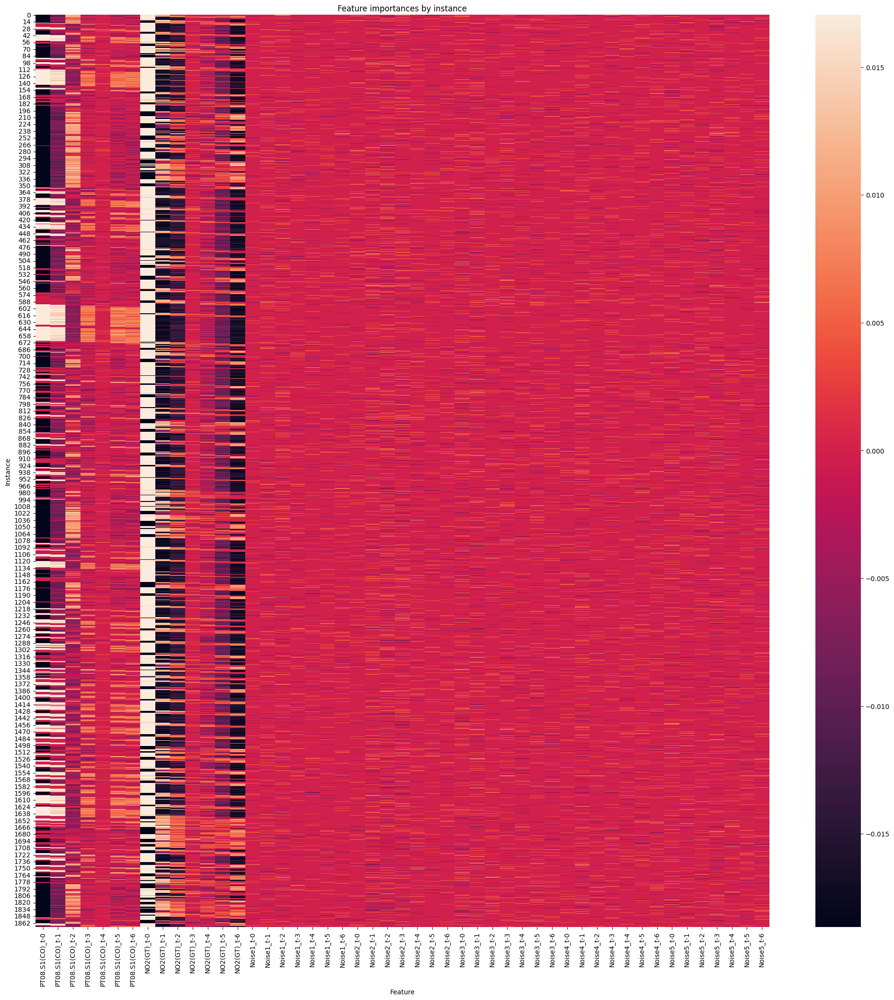

Top features for value:
NO2(GT)_t-0
PT08.S1(CO)_t-0
NO2(GT)_t-1
NO2(GT)_t-6
NO2(GT)_t-2
PT08.S1(CO)_t-1
NO2(GT)_t-5
PT08.S1(CO)_t-2
NO2(GT)_t-4
PT08.S1(CO)_t-5
PT08.S1(CO)_t-3
PT08.S1(CO)_t-6
Noise2_t-2
Noise2_t-1
Noise2_t-3
NO2(GT)_t-3
Noise3_t-1
Noise1_t-2
Noise5_t-3
Noise3_t-0
Top features for presence:
NO2(GT)_t-0
NO2(GT)_t-1
NO2(GT)_t-2
NO2(GT)_t-6
PT08.S1(CO)_t-0
NO2(GT)_t-5
PT08.S1(CO)_t-1
PT08.S1(CO)_t-2
NO2(GT)_t-4
PT08.S1(CO)_t-5
PT08.S1(CO)_t-3
PT08.S1(CO)_t-6
Noise2_t-2
Noise2_t-3
Noise2_t-1
NO2(GT)_t-3
Noise3_t-1
Noise1_t-2
Noise4_t-1
Noise3_t-0


In [9]:
explain_all_samples(X_train, X_test, model, input_features)

Ok, now let's try with the Covid data:

In [26]:
import seaborn as sns
import matplotlib.pyplot as plt

df_covid = pd.read_csv("datasetCovidLombardy.csv", parse_dates=["data"], index_col="data")
df_covid = df_covid.drop('totale_ospedalizzati', axis=1)
df_covid = df_covid.drop('isolamento_domiciliare', axis=1)
df_covid = df_covid.drop('stato', axis=1)
df_covid = df_covid.drop('codice_regione', axis=1)
df_covid = df_covid.drop('denominazione_regione', axis=1)
df_covid = df_covid.drop('lat', axis=1)
df_covid = df_covid.drop('long', axis=1)
df_covid = df_covid.drop('casi_da_sospetto_diagnostico', axis=1)
df_covid = df_covid.drop('casi_da_screening', axis=1)
df_covid = df_covid.drop('note', axis=1)
df_covid = df_covid.drop('note_test', axis=1)
df_covid = df_covid.drop('note_casi', axis=1)
df_covid = df_covid.drop('codice_nuts_1', axis=1)
df_covid = df_covid.drop('codice_nuts_2', axis=1)
df_covid['tamponi_test_antigenico_rapido'] = df_covid['tamponi_test_antigenico_rapido'].fillna(0)
df_covid['totale_positivi_test_antigenico_rapido'] = df_covid['totale_positivi_test_antigenico_rapido'].fillna(0)
df_covid['ingressi_terapia_intensiva'] = df_covid['ingressi_terapia_intensiva'].fillna(0)
df_covid['casi_testati'] = df_covid['casi_testati'].fillna(0)
df_covid['tamponi_test_molecolare'] = df_covid['tamponi_test_molecolare'].fillna(df_covid['tamponi'])
df_covid['totale_positivi_test_molecolare'] = df_covid['totale_positivi_test_molecolare'].fillna(df_covid['totale_positivi'])
df_covid = df_covid.rename(columns={"nuovi_positivi":"Y"})

# drop all the columns except fot variazione_totale_positivi, Y and tamponi
df_covid = df_covid.drop(['ricoverati_con_sintomi', 'terapia_intensiva', 'totale_positivi','dimessi_guariti', 'deceduti', 'totale_casi', 'casi_testati', 'ingressi_terapia_intensiva', 'totale_positivi_test_molecolare', 'totale_positivi_test_antigenico_rapido', 'tamponi_test_molecolare', 'tamponi_test_antigenico_rapido'], axis=1)

# Add noise features
for i in range(5):
    df_covid[f'Noise{i+1}'] = np.random.normal(0, 1, len(df_covid))

from sklearn.model_selection import train_test_split


features = df_covid.columns.values
index = np.argwhere(features=='Y')
input_features = np.delete(features, index)

output_feature = np.array(['Y'])
window_size = 7
stride = 1


# create lists to store the samples and labels
samples = []
labels = []

# slide the window over the data and extract samples and labels
for i in range(0, len(df_covid) - window_size+1, stride):
    # extract the input features
    X = df_covid.iloc[i:i+window_size, df_covid.columns != 'Y'].values
    samples.append(X)

    # extract the output feature for this window
    y = df_covid.iloc[i+window_size-1][output_feature]
    labels.append(y)



# convert the lists to numpy arrays
samples = np.array(samples)
labels = np.array(labels)

X_train, X_test, y_train, y_test = train_test_split(samples, labels, test_size=0.2, shuffle=False)

In [27]:
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
from keras.optimizers import Adam
from keras.callbacks import ReduceLROnPlateau
from sklearn.preprocessing import MinMaxScaler

# Normalize the input data
scaler_x = MinMaxScaler()
scaler_y = MinMaxScaler()

X_train = scaler_x.fit_transform(X_train.reshape(-1, X_train.shape[-1])).reshape(X_train.shape)
X_test = scaler_x.transform(X_test.reshape(-1, X_test.shape[-1])).reshape(X_test.shape)
y_train = scaler_y.fit_transform(y_train)
y_test = scaler_y.transform(y_test)

input_shape = (X_train.shape[1], X_train.shape[2])

model = Sequential()
model.add(LSTM(100, input_shape=input_shape, return_sequences=True))
model.add(Dropout(0.2))
model.add(LSTM(100, return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(1))

optimizer = Adam(learning_rate=0.01)
model.compile(optimizer=optimizer, loss='mse')

# Adding a learning rate scheduler
lr_scheduler = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.0001)

history = model.fit(X_train, y_train, epochs=200, batch_size=16, validation_data=(X_test, y_test), callbacks=[lr_scheduler])

# Make predictions using the trained model
y_pred = model.predict(X_test)

# Inverse transform the predictions to the original scale
y_pred = scaler_y.inverse_transform(y_pred)
y_test = scaler_y.inverse_transform(y_test)

Epoch 1/200
55/55 [==============================] - 4s 15ms/step - loss: 0.0652 - val_loss: 0.0155 - lr: 0.0100
Epoch 2/200
55/55 [==============================] - 0s 6ms/step - loss: 0.0140 - val_loss: 0.0089 - lr: 0.0100
Epoch 3/200
55/55 [==============================] - 0s 6ms/step - loss: 0.0132 - val_loss: 0.0624 - lr: 0.0100
Epoch 4/200
55/55 [==============================] - 0s 5ms/step - loss: 0.0135 - val_loss: 0.0145 - lr: 0.0100
Epoch 5/200
55/55 [==============================] - 0s 5ms/step - loss: 0.0129 - val_loss: 0.0039 - lr: 0.0100
Epoch 6/200
55/55 [==============================] - 0s 5ms/step - loss: 0.0131 - val_loss: 0.0255 - lr: 0.0100
Epoch 7/200
55/55 [==============================] - 0s 6ms/step - loss: 0.0123 - val_loss: 0.0090 - lr: 0.0100
Epoch 8/200
55/55 [==============================] - 0s 6ms/step - loss: 0.0125 - val_loss: 0.0043 - lr: 0.0100
Epoch 9/200
55/55 [==============================] - 0s 6ms/step - loss: 0.0159 - val_loss: 0.0105 - lr

157/157 [==============================] - 0s 3ms/step


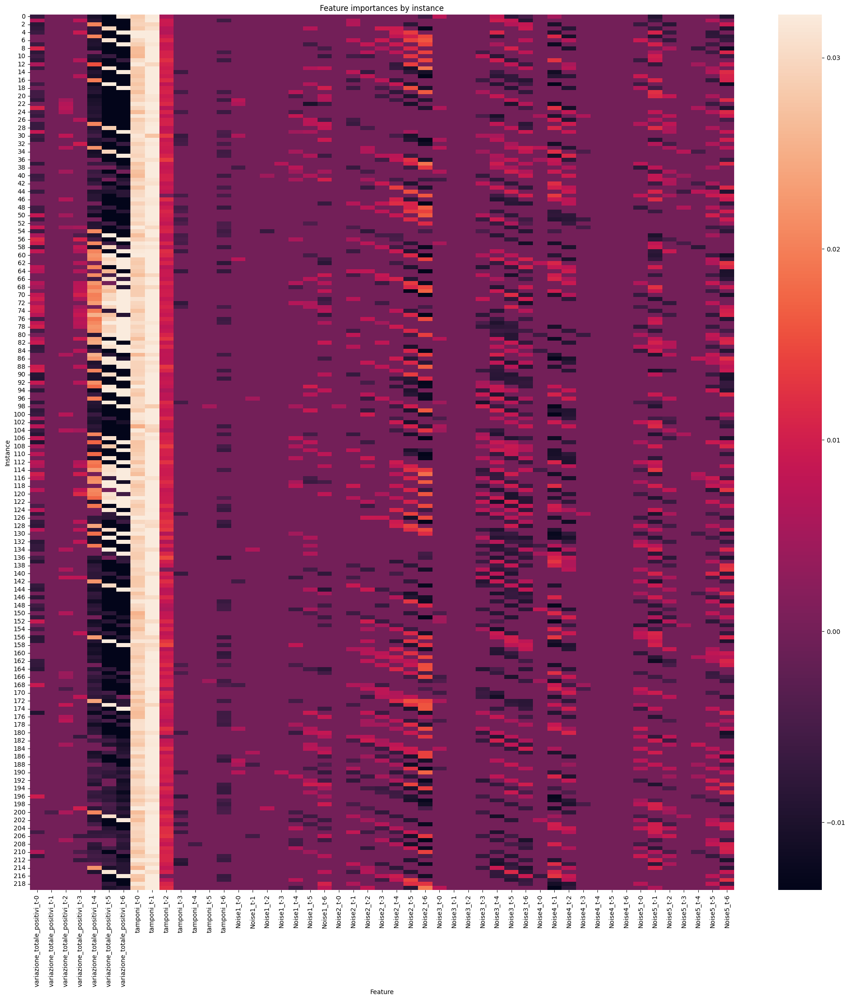

Top features for value:
tamponi_t-1
tamponi_t-0
variazione_totale_positivi_t-6
variazione_totale_positivi_t-5
variazione_totale_positivi_t-4
tamponi_t-2
Noise2_t-6
Noise5_t-6
Noise4_t-1
Noise2_t-5
Noise5_t-1
Noise3_t-4
Noise3_t-5
Noise3_t-6
variazione_totale_positivi_t-0
Noise4_t-2
Noise2_t-4
Noise5_t-5
Noise3_t-3
Noise1_t-6
Top features for presence:
tamponi_t-0
tamponi_t-1
variazione_totale_positivi_t-6
tamponi_t-2
variazione_totale_positivi_t-5
variazione_totale_positivi_t-4
Noise5_t-6
Noise3_t-4
Noise2_t-6
Noise5_t-1
Noise3_t-5
Noise3_t-6
variazione_totale_positivi_t-0
Noise4_t-1
Noise2_t-5
Noise4_t-2
Noise5_t-5
Noise2_t-4
Noise3_t-3
tamponi_t-6


In [28]:
explain_all_samples(X_train, X_test, model, input_features)

In [29]:
from sklearn.metrics import mean_absolute_error
mean_absolute_error(y_test, y_pred)

4366.975021084872